# NBA Outlier Analysis

In the following project, I will focus on player metrics, which evaluate the player's performance in the league. More specifically, I want to determine positive and negative outliers based on the metrics I will use.
The metrics that I will be using for the project are the following:

- Effective field goal percentage (eFG%)
- True shooting percentage (TS%)
- Player efficiency rating (PER)
- FG => 2P & 3P

To do that, we will use data from 1997 - 2023 and average data from 1984 - 2023.

(Tiodorovic, 2020), (STACK NJ/NY, 2021), (basketball stats, 2021)

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
##in case you have not installed it yet
#!pip install plotly
import plotly.express as px
import time

In the previous Jupiter notebook, I showcased how the data was gathered and cleaned. Therefore, we are not required to clean the data again and can move directly to the exploratory analysis.

## Exploratory Analysis

In [2]:
pd.set_option('display.max_columns',100)
df=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case Study\Basketball\NBA_1997_2023.csv").drop(['Unnamed: 0'],axis=1)
df.head()

,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,PG%,SG%,SF%,PF%,C%,OnCourt,On-Off,BadPass,LostBall,Shooting_Fouls_Committed,Offensive_Fouls_Committed,Shooting_Fouls_Drawn,Offensive_Fouls_Drawn,PGA,And1,Blkd,Year
0,Mahmoud Abdul-Rauf,PG,27,SAC,75,51,2131,411,924,0.445,94,246,0.382,317,678,0.468,0.496,115,136,0.846,16,106,122,189,56,6,119,174,1031,13.2,0.524,0.266,0.147,0.9,5.9,3.3,15.8,1.4,0.2,10.8,23.2,2.0,0.7,2.7,0.060,-0.8,-1.8,-2.6,-0.4,0.89,0.11,0.00,0.00,0.0,-5.9,-3.2,73,14,84,4,29,0,409,4,30,1997
1,Shareef Abdur-Rahim,PF,20,VAN,80,71,2802,550,1214,0.453,7,27,0.259,543,1187,0.457,0.456,387,519,0.746,216,339,555,175,79,79,225,199,1494,17.4,0.518,0.022,0.428,8.8,14.2,11.5,12.1,1.5,2.2,13.5,27.6,1.7,1.2,2.9,0.049,0.3,-2.1,-1.8,0.2,0.00,0.00,0.35,0.64,0.0,-11.5,-3.9,85,58,88,27,220,0,387,51,162,1997
2,Rafael Addison,SF,32,CHH,41,3,355,49,122,0.402,8,20,0.400,41,102,0.402,0.434,22,28,0.786,19,26,45,34,8,3,17,52,128,10.6,0.476,0.164,0.230,6.7,8.6,7.7,15.5,1.2,0.6,11.2,20.1,0.2,0.1,0.4,0.048,-2.6,-1.7,-4.4,-0.2,0.00,0.45,0.55,0.00,0.0,-3.3,-7.6,7,2,30,3,6,0,79,2,5,1997
3,Cory Alexander,PG,23,SAS,80,6,1454,194,490,0.396,94,252,0.373,100,238,0.420,0.492,95,129,0.736,29,94,123,254,82,16,146,148,577,14.3,0.528,0.514,0.263,2.3,8.0,5.1,30.0,3.1,0.9,21.1,22.2,0.5,0.6,1.1,0.035,0.3,-0.8,-0.6,0.5,0.94,0.06,0.00,0.00,0.0,-9.7,-1.1,83,26,71,9,38,0,540,6,23,1997
4,Jerome Allen,SG,24,TOT,76,1,943,78,221,0.353,30,93,0.323,48,128,0.375,0.421,42,72,0.583,25,73,98,152,31,4,69,84,228,8.7,0.451,0.421,0.326,3.1,9.0,6.1,25.3,1.8,0.3,21.4,15.6,-0.3,0.8,0.4,0.021,-2.5,-0.2,-2.6,-0.1,0.72,0.25,0.02,0.00,0.0,-2.6,-1.8,50,4,25,6,27,0,346,5,15,1997


In [3]:
#Tm showcases writen out teams
df['Tm'].replace({'SAC':'Sacramento Kings','VAN':'Vancouver Grizzlies','CHH':'Charlotte Hornets','SAS':'San Antonio Spurs',
                 'IND':'Indiana Pacers', 'DEN':'Denver Nuggets','MIL':'Milwaukee Bucks','ATL':'Atlanta Hawks','WSB':'Washington Bullets',
                 'POR':'Portland Trail Blazers','ORL':'Orlando Magic','UTA':'Utah Jazz','MIA':'Miami Heat','GSW':'Golden State Warriors',
                 'NJN':'New Jersey Nets','DET':'Detroit Pistons','HOU':'Houston Rockets','BOS':'Boston Celtics','LAC':'Los Angeles Clippers',
                 'TOR':'Toronto Raptors','LAL':'Los Angeles Lakers','PHO':'Phoenix Suns','DAL':'Dallas Mavericks','PHI':'Philadelphia 76ers',
                 'CLE':'Cleveland Cavaliers','NYK':'New York Knicks','CHI':'Chicago Bulls','MIN':'Minnesota Timberwolves','SEA':'Seattle SuperSonics',
                 'WAS':'Washington Wizards','MEM':'Memphis Grizzlies','NOH':'New Orleans Hornets','CHA':'Charlotte Bobcats','NOK':'New Orleans/Pklahoma City Hornets',
                 'OKC':'Oklahoma City Thunder','BRK':'Brooklyn Nets','NOP':'New Orleans Pelicans','CHO':'Charlotte Hornets',
                 'TOT':'more than 2 Teams'}, inplace=True)
df['Player']=df['Player'].apply(lambda x: x[:-1] if x[-1]=='*' else x)
df.head()

,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,PG%,SG%,SF%,PF%,C%,OnCourt,On-Off,BadPass,LostBall,Shooting_Fouls_Committed,Offensive_Fouls_Committed,Shooting_Fouls_Drawn,Offensive_Fouls_Drawn,PGA,And1,Blkd,Year
0,Mahmoud Abdul-Rauf,PG,27,Sacramento Kings,75,51,2131,411,924,0.445,94,246,0.382,317,678,0.468,0.496,115,136,0.846,16,106,122,189,56,6,119,174,1031,13.2,0.524,0.266,0.147,0.9,5.9,3.3,15.8,1.4,0.2,10.8,23.2,2.0,0.7,2.7,0.060,-0.8,-1.8,-2.6,-0.4,0.89,0.11,0.00,0.00,0.0,-5.9,-3.2,73,14,84,4,29,0,409,4,30,1997
1,Shareef Abdur-Rahim,PF,20,Vancouver Grizzlies,80,71,2802,550,1214,0.453,7,27,0.259,543,1187,0.457,0.456,387,519,0.746,216,339,555,175,79,79,225,199,1494,17.4,0.518,0.022,0.428,8.8,14.2,11.5,12.1,1.5,2.2,13.5,27.6,1.7,1.2,2.9,0.049,0.3,-2.1,-1.8,0.2,0.00,0.00,0.35,0.64,0.0,-11.5,-3.9,85,58,88,27,220,0,387,51,162,1997
2,Rafael Addison,SF,32,Charlotte Hornets,41,3,355,49,122,0.402,8,20,0.400,41,102,0.402,0.434,22,28,0.786,19,26,45,34,8,3,17,52,128,10.6,0.476,0.164,0.230,6.7,8.6,7.7,15.5,1.2,0.6,11.2,20.1,0.2,0.1,0.4,0.048,-2.6,-1.7,-4.4,-0.2,0.00,0.45,0.55,0.00,0.0,-3.3,-7.6,7,2,30,3,6,0,79,2,5,1997
3,Cory Alexander,PG,23,San Antonio Spurs,80,6,1454,194,490,0.396,94,252,0.373,100,238,0.420,0.492,95,129,0.736,29,94,123,254,82,16,146,148,577,14.3,0.528,0.514,0.263,2.3,8.0,5.1,30.0,3.1,0.9,21.1,22.2,0.5,0.6,1.1,0.035,0.3,-0.8,-0.6,0.5,0.94,0.06,0.00,0.00,0.0,-9.7,-1.1,83,26,71,9,38,0,540,6,23,1997
4,Jerome Allen,SG,24,more than 2 Teams,76,1,943,78,221,0.353,30,93,0.323,48,128,0.375,0.421,42,72,0.583,25,73,98,152,31,4,69,84,228,8.7,0.451,0.421,0.326,3.1,9.0,6.1,25.3,1.8,0.3,21.4,15.6,-0.3,0.8,0.4,0.021,-2.5,-0.2,-2.6,-0.1,0.72,0.25,0.02,0.00,0.0,-2.6,-1.8,50,4,25,6,27,0,346,5,15,1997


In [4]:
#in this section, I have created columns which indicate if a player has accomplished an award
df_season_avg=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case Study\Basketball\Season_output_1997_2023.csv").iloc[:,1:]
df=pd.merge(df,df_season_avg, how='left',on='Year')

#here, I have created a for-loop that checks if a player matches has accomplished one of the awards,
##if that is the case, the player will receive a 1, if not a 0
cols=list(df_season_avg.columns[1:-1])
for col in cols:
    df[col]=np.where(df['Player']==df[col],1,0)

df['League Champion']=np.where(df['Tm']==df['League Champion'],1,0)
df.head()

,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,PG%,SG%,SF%,PF%,C%,OnCourt,On-Off,BadPass,LostBall,Shooting_Fouls_Committed,Offensive_Fouls_Committed,Shooting_Fouls_Drawn,Offensive_Fouls_Drawn,PGA,And1,Blkd,Year,League Champion,Most Valuable Player,Rookie of the Year,PPG Leader,RPG Leader,APG Leader,Win Share Leader
0,Mahmoud Abdul-Rauf,PG,27,Sacramento Kings,75,51,2131,411,924,0.445,94,246,0.382,317,678,0.468,0.496,115,136,0.846,16,106,122,189,56,6,119,174,1031,13.2,0.524,0.266,0.147,0.9,5.9,3.3,15.8,1.4,0.2,10.8,23.2,2.0,0.7,2.7,0.060,-0.8,-1.8,-2.6,-0.4,0.89,0.11,0.00,0.00,0.0,-5.9,-3.2,73,14,84,4,29,0,409,4,30,1997,0,0,0,0,0,0,0
1,Shareef Abdur-Rahim,PF,20,Vancouver Grizzlies,80,71,2802,550,1214,0.453,7,27,0.259,543,1187,0.457,0.456,387,519,0.746,216,339,555,175,79,79,225,199,1494,17.4,0.518,0.022,0.428,8.8,14.2,11.5,12.1,1.5,2.2,13.5,27.6,1.7,1.2,2.9,0.049,0.3,-2.1,-1.8,0.2,0.00,0.00,0.35,0.64,0.0,-11.5,-3.9,85,58,88,27,220,0,387,51,162,1997,0,0,0,0,0,0,0
2,Rafael Addison,SF,32,Charlotte Hornets,41,3,355,49,122,0.402,8,20,0.400,41,102,0.402,0.434,22,28,0.786,19,26,45,34,8,3,17,52,128,10.6,0.476,0.164,0.230,6.7,8.6,7.7,15.5,1.2,0.6,11.2,20.1,0.2,0.1,0.4,0.048,-2.6,-1.7,-4.4,-0.2,0.00,0.45,0.55,0.00,0.0,-3.3,-7.6,7,2,30,3,6,0,79,2,5,1997,0,0,0,0,0,0,0
3,Cory Alexander,PG,23,San Antonio Spurs,80,6,1454,194,490,0.396,94,252,0.373,100,238,0.420,0.492,95,129,0.736,29,94,123,254,82,16,146,148,577,14.3,0.528,0.514,0.263,2.3,8.0,5.1,30.0,3.1,0.9,21.1,22.2,0.5,0.6,1.1,0.035,0.3,-0.8,-0.6,0.5,0.94,0.06,0.00,0.00,0.0,-9.7,-1.1,83,26,71,9,38,0,540,6,23,1997,0,0,0,0,0,0,0
4,Jerome Allen,SG,24,more than 2 Teams,76,1,943,78,221,0.353,30,93,0.323,48,128,0.375,0.421,42,72,0.583,25,73,98,152,31,4,69,84,228,8.7,0.451,0.421,0.326,3.1,9.0,6.1,25.3,1.8,0.3,21.4,15.6,-0.3,0.8,0.4,0.021,-2.5,-0.2,-2.6,-0.1,0.72,0.25,0.02,0.00,0.0,-2.6,-1.8,50,4,25,6,27,0,346,5,15,1997,0,0,0,0,0,0,0


In [5]:
#first, let's create a new column which showcases the percentage of how many games a player played as a starter
df['Starting%_float']=round(df['GS']/df['G'],3)
df['Starting%_str']=round(df['GS']/df['G'],3)*100
df['Starting%_str']=df['Starting%_str'].astype(str).apply(lambda x: x+"%")
df.head()

,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,PG%,SG%,SF%,PF%,C%,OnCourt,On-Off,BadPass,LostBall,Shooting_Fouls_Committed,Offensive_Fouls_Committed,Shooting_Fouls_Drawn,Offensive_Fouls_Drawn,PGA,And1,Blkd,Year,League Champion,Most Valuable Player,Rookie of the Year,PPG Leader,RPG Leader,APG Leader,Win Share Leader,Starting%_float,Starting%_str
0,Mahmoud Abdul-Rauf,PG,27,Sacramento Kings,75,51,2131,411,924,0.445,94,246,0.382,317,678,0.468,0.496,115,136,0.846,16,106,122,189,56,6,119,174,1031,13.2,0.524,0.266,0.147,0.9,5.9,3.3,15.8,1.4,0.2,10.8,23.2,2.0,0.7,2.7,0.060,-0.8,-1.8,-2.6,-0.4,0.89,0.11,0.00,0.00,0.0,-5.9,-3.2,73,14,84,4,29,0,409,4,30,1997,0,0,0,0,0,0,0,0.680,68.0%
1,Shareef Abdur-Rahim,PF,20,Vancouver Grizzlies,80,71,2802,550,1214,0.453,7,27,0.259,543,1187,0.457,0.456,387,519,0.746,216,339,555,175,79,79,225,199,1494,17.4,0.518,0.022,0.428,8.8,14.2,11.5,12.1,1.5,2.2,13.5,27.6,1.7,1.2,2.9,0.049,0.3,-2.1,-1.8,0.2,0.00,0.00,0.35,0.64,0.0,-11.5,-3.9,85,58,88,27,220,0,387,51,162,1997,0,0,0,0,0,0,0,0.888,88.8%
2,Rafael Addison,SF,32,Charlotte Hornets,41,3,355,49,122,0.402,8,20,0.400,41,102,0.402,0.434,22,28,0.786,19,26,45,34,8,3,17,52,128,10.6,0.476,0.164,0.230,6.7,8.6,7.7,15.5,1.2,0.6,11.2,20.1,0.2,0.1,0.4,0.048,-2.6,-1.7,-4.4,-0.2,0.00,0.45,0.55,0.00,0.0,-3.3,-7.6,7,2,30,3,6,0,79,2,5,1997,0,0,0,0,0,0,0,0.073,7.3%
3,Cory Alexander,PG,23,San Antonio Spurs,80,6,1454,194,490,0.396,94,252,0.373,100,238,0.420,0.492,95,129,0.736,29,94,123,254,82,16,146,148,577,14.3,0.528,0.514,0.263,2.3,8.0,5.1,30.0,3.1,0.9,21.1,22.2,0.5,0.6,1.1,0.035,0.3,-0.8,-0.6,0.5,0.94,0.06,0.00,0.00,0.0,-9.7,-1.1,83,26,71,9,38,0,540,6,23,1997,0,0,0,0,0,0,0,0.075,7.5%
4,Jerome Allen,SG,24,more than 2 Teams,76,1,943,78,221,0.353,30,93,0.323,48,128,0.375,0.421,42,72,0.583,25,73,98,152,31,4,69,84,228,8.7,0.451,0.421,0.326,3.1,9.0,6.1,25.3,1.8,0.3,21.4,15.6,-0.3,0.8,0.4,0.021,-2.5,-0.2,-2.6,-0.1,0.72,0.25,0.02,0.00,0.0,-2.6,-1.8,50,4,25,6,27,0,346,5,15,1997,0,0,0,0,0,0,0,0.013,1.3%


In [6]:
#def function to showcase the maximum percentage of a position based on a particular team, year and percentage value
def starting_pos(value,year,team):
    df_starter=df[df['G']>=(82*(2/3))].groupby(['Year','Tm','Pos'])['Starting%_float'].max().to_frame().reset_index()
    
    data=df_starter[(df_starter['Starting%_float']<value) 
                    & (df_starter['Year']==year)
                    & (df_starter['Tm']==team)]
    per_value=(value*100).astype(str)+"%"
    if len(data) == 0:
        print('No Results for the {} in {}, we can assume, the starting lineup did not change during the season'.format(team, year))
    else:
        plt.figure(figsize=(12,10))
        ax=sns.barplot(x='Pos', y='Starting%_float',
                   data=data, estimator=np.max)
        for x in ax.containers:
            ax.bar_label(x,)
        plt.title('Position(s) where less than {} of the same Player of the {}, started the Games in {}'.format(per_value,
                data['Tm'].unique()[0],data['Year'].unique()[0]),fontweight='bold')

Please enter a float value which is in the range of 0.001 and 1.000: 1.000
Please enter the years as an integer: 2008
Please enter the team that you want to analyse: Los Angeles Lakers


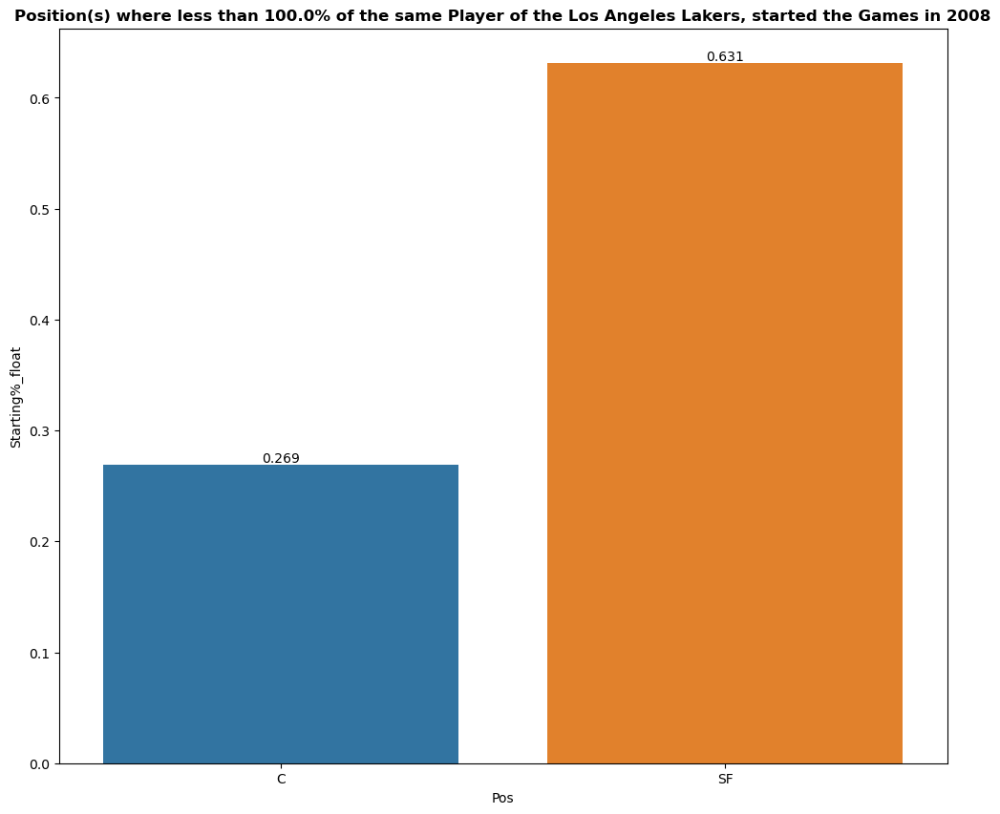

In [7]:
starting_pos(pd.to_numeric(input('Please enter a float value which is in the range of 0.001 and 1.000: '))
             ,pd.to_numeric(input('Please enter the years as an integer: ')),
             input('Please enter the team that you want to analyse: '))

Enter the year: 2008
Enter the Team-Name: Los Angeles Lakers


C:\Users\gandj\AppData\Local\Temp\ipykernel_15372\2896732046.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,14))


,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,OWS,DWS,WS,WS/48,OBPM,DBPM,BPM,VORP,PG%,SG%,SF%,PF%,C%,OnCourt,On-Off,BadPass,LostBall,Shooting_Fouls_Committed,Offensive_Fouls_Committed,Shooting_Fouls_Drawn,Offensive_Fouls_Drawn,PGA,And1,Blkd,Year,League Champion,Most Valuable Player,Rookie of the Year,PPG Leader,RPG Leader,APG Leader,Win Share Leader,Starting%_float,Starting%_str
5916,Trevor Ariza,SF,22,Los Angeles Lakers,24,3,431,55,105,0.524,5,15,0.333,50,90,0.556,0.548,41,60,0.683,25,59,84,36,26,8,18,36,156,17.1,0.594,0.143,0.571,6.7,14.6,10.8,12.0,3.0,1.3,12.0,15.3,0.9,0.7,1.6,0.176,1.0,2.1,3.1,0.6,0.00,0.02,0.95,0.03,0.00,1.8,-6.6,12,1,17,2,24,1,83,4,5,2008,0,0,0,0,0,0,0,0.125,12.5%
5969,Kwame Brown,C,25,Los Angeles Lakers,23,14,509,53,103,0.515,0,0,0.000,53,103,0.515,0.515,26,64,0.406,31,100,131,28,16,19,37,58,132,9.7,0.503,0.000,0.621,7.0,20.9,14.3,7.7,1.6,2.7,22.0,14.6,-0.3,0.8,0.5,0.047,-3.3,1.4,-1.9,0.0,0.00,0.00,0.00,0.00,1.00,-3.5,-12.9,8,12,32,9,32,7,60,2,13,2008,0,0,0,0,0,0,0,0.609,60.9%
5975,Kobe Bryant,SG,29,Los Angeles Lakers,82,82,3192,775,1690,0.459,150,415,0.361,625,1275,0.490,0.503,623,742,0.840,94,423,517,441,151,40,257,227,2323,24.2,0.576,0.246,0.439,3.4,14.1,9.0,23.9,2.4,0.9,11.3,31.4,9.5,4.3,13.8,0.208,5.2,0.6,5.8,6.3,0.01,0.96,0.03,0.00,0.00,9.0,7.0,112,85,80,29,312,8,1017,64,66,2008,0,1,0,0,0,0,0,1.000,100.0%
5979,Andrew Bynum,C,20,Los Angeles Lakers,35,25,1008,189,297,0.636,0,0,0.000,189,297,0.636,0.636,82,118,0.695,105,251,356,61,12,72,52,98,460,22.6,0.659,0.000,0.397,12.1,26.6,19.6,9.6,0.6,5.1,13.0,17.5,3.0,1.8,4.8,0.230,2.9,1.3,4.2,1.6,0.00,0.00,0.00,0.00,1.00,10.9,4.4,10,15,60,10,64,1,134,22,29,2008,0,0,0,0,0,0,0,0.714,71.39999999999999%
6001,Brian Cook,PF,27,Los Angeles Lakers,6,2,70,4,21,0.190,2,10,0.200,2,11,0.182,0.238,4,4,0.100,4,6,10,3,2,0,4,6,14,1.2,0.308,0.476,0.190,6.6,9.1,7.9,5.6,1.4,0.0,14.9,16.9,-0.2,0.1,-0.1,-0.087,-5.6,-1.9,-7.5,-0.1,0.00,0.00,0.47,0.52,0.00,-7.2,-15.1,2,2,4,0,2,2,6,0,1,2008,0,0,0,0,0,0,0,0.333,33.300000000000004%
6006,Javaris Crittenton,SG,20,Los Angeles Lakers,22,0,171,26,53,0.491,1,3,0.333,25,50,0.500,0.500,19,28,0.679,7,14,21,18,7,0,22,12,72,11.0,0.551,0.057,0.528,4.7,8.7,6.8,15.7,2.1,0.0,25.2,22.5,-0.1,0.2,0.0,0.013,-3.2,-1.2,-4.3,-0.1,0.22,0.78,0.00,0.00,0.00,-8.7,-17.2,7,7,2,4,13,0,41,4,7,2008,0,0,0,0,0,0,0,0.000,0.0%
6051,Maurice Evans,SG,29,Los Angeles Lakers,7,0,96,9,28,0.321,1,7,0.143,8,21,0.381,0.339,12,15,0.800,4,5,9,12,5,1,0,10,31,13.3,0.448,0.250,0.536,4.8,5.6,5.2,17.2,2.6,0.8,0.0,15.9,0.2,0.1,0.3,0.140,-0.2,2.2,2.0,0.1,0.00,0.97,0.03,0.00,0.00,16.6,9.2,0,0,3,0,8,0,28,1,2,2008,0,0,0,0,0,0,0,0.000,0.0%
6054,Jordan Farmar,PG,21,Los Angeles Lakers,82,0,1690,291,631,0.461,114,307,0.371,177,324,0.546,0.552,53,78,0.679,39,144,183,225,77,5,108,105,749,15.4,0.563,0.487,0.124,2.7,9.1,6.0,20.5,2.3,0.2,14.0,20.2,2.1,1.8,3.9,0.111,1.3,0.0,1.3,1.4,1.00,0.00,0.00,0.00,0.00,9.1,2.5,65,22,27,10,36,6,524,15,21,2008,0,0,0,0,0,0,0,0.000,0.0%
6061,Derek Fisher,PG,33,Los Angeles Lakers,82,82,2249,339,777,0.436,112,276,0.406,227,501,0.453,0.508,166,188,0.883,24,146,170,239,86,3,90,188,956,13.8,0.556,0.355,0.242,1.2,6.9,4.2,15.9,1.9,0.1,9.5,18.6,3.7,2.0,5.7,0.121,-0.3,0.0,-0.4,0.9,0.98,0.03,0.00,0.00,0.00,6.7,-2.2,59,17,77,10,58,55,532,9,33,2008,0,0,0,0,0,0,0,1.000,100.0%
6077,Pau Gasol,C,27,Los Angeles Lakers,27,27,918,196,333,0.589,0,1,0.000,196,332,0.590,0.589,116,147,0.789,61,150,211,95,14,42,44,54,508,24.0,0.639,0.003,0.441,7.7,17.4,12.8,17.0,0.8,3.3,10.0,21.2,3.4,1.2,4.6,0.239,4.7,0.8,5.5,1.7,0.00,0.00,0.00,0.00,1.00,14.1,8.3,22,13,28,4,64,6,220,17,19,2008,0,0,0,0,0,0,0,1.000,100.0%


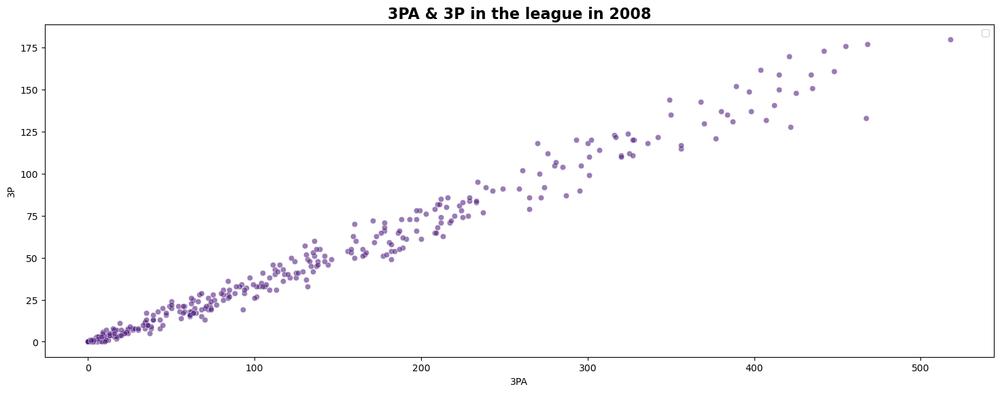

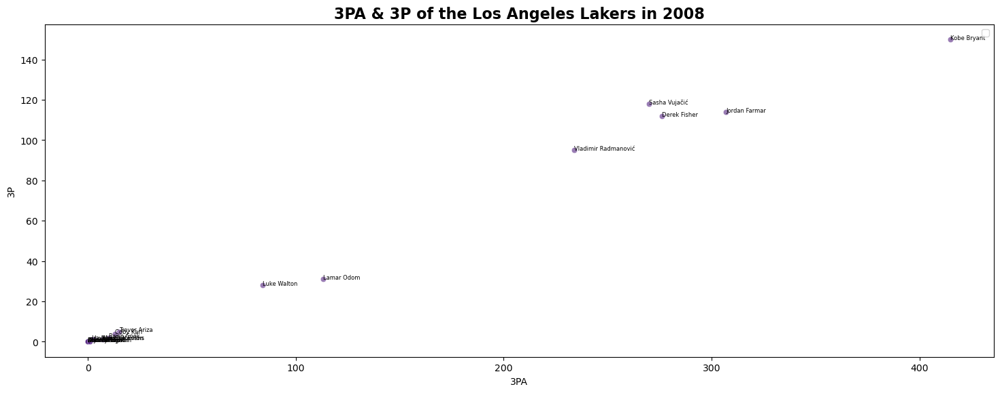

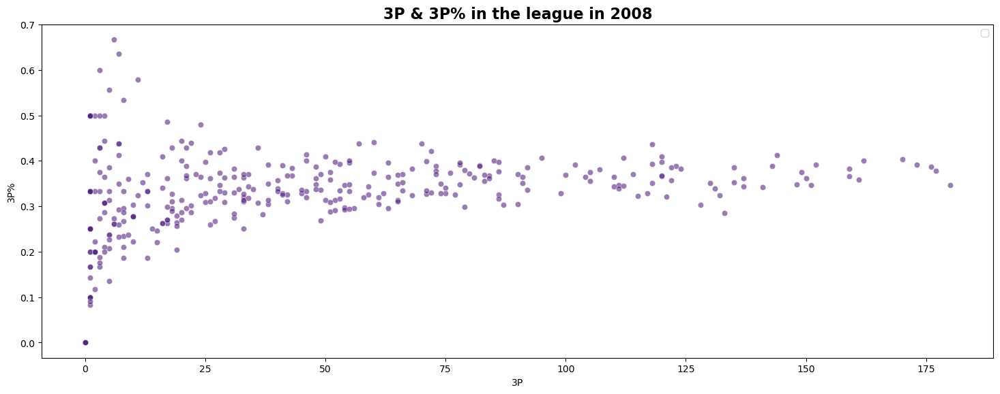

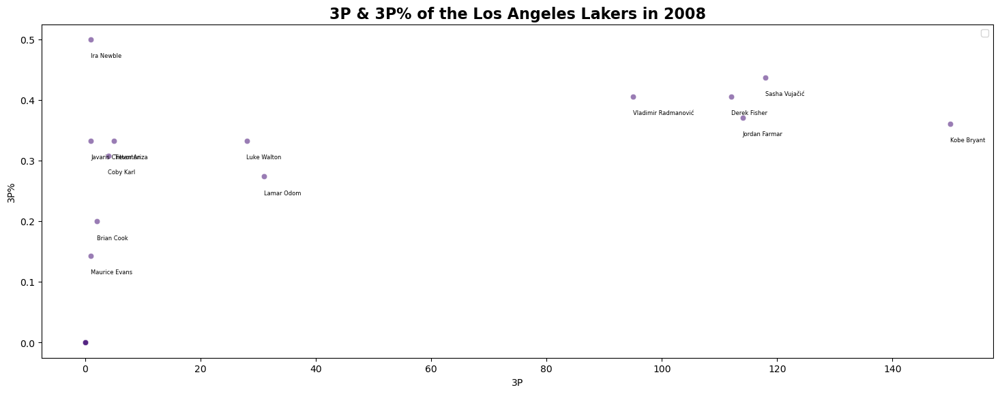

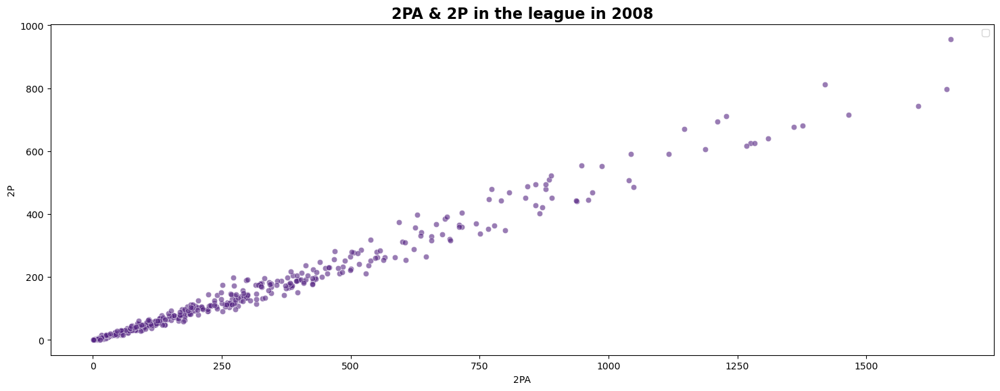

...

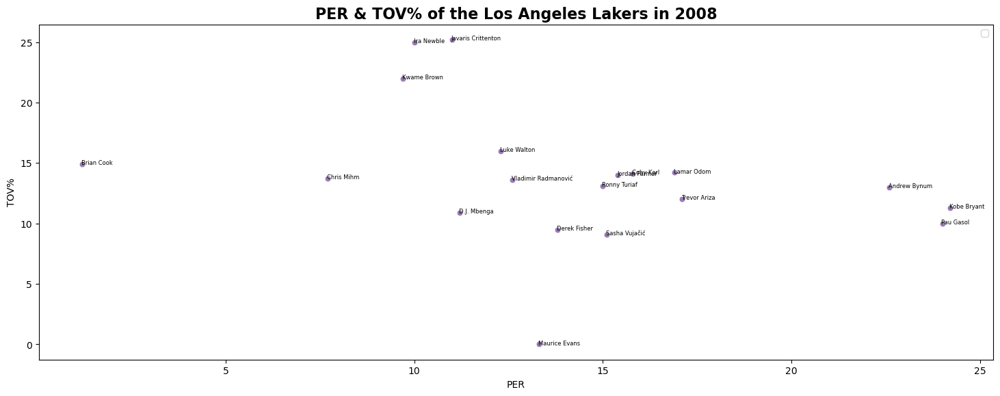

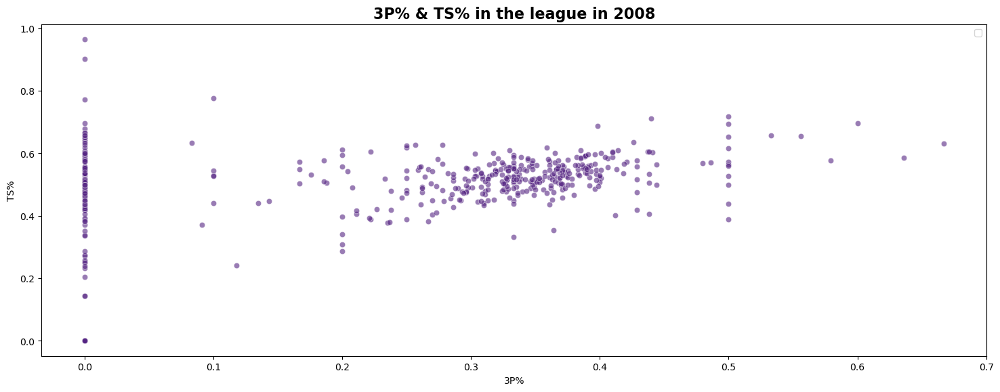

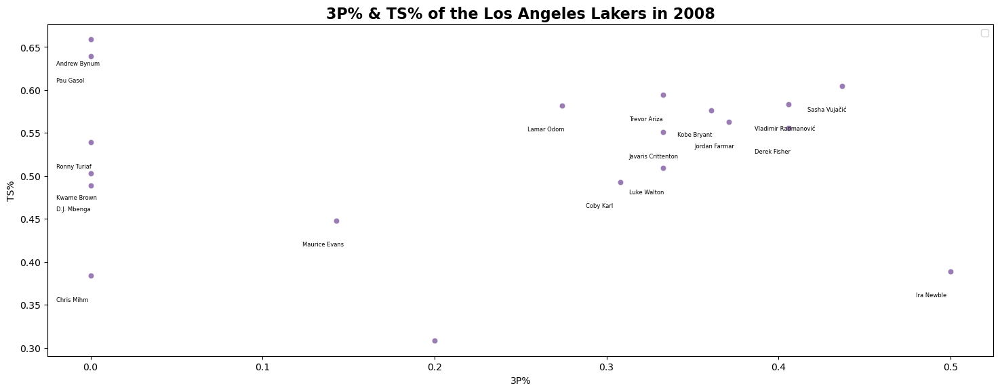

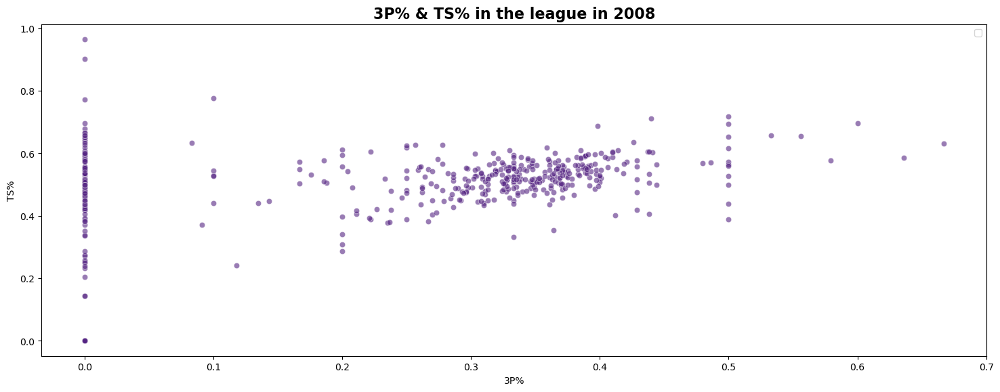

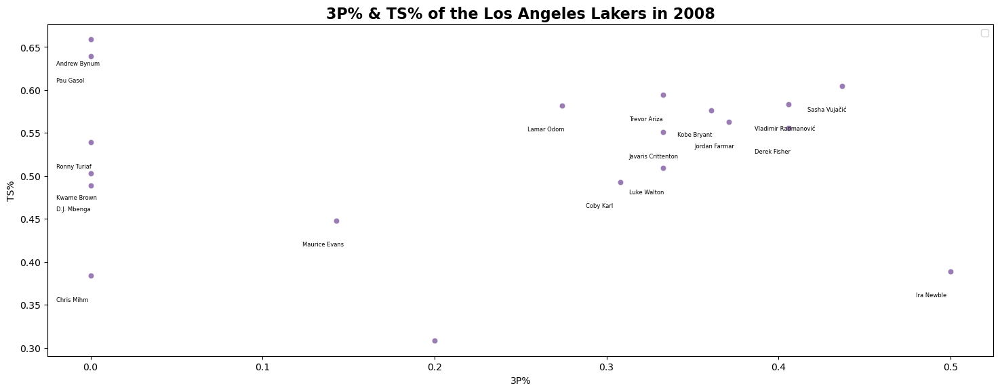

In [8]:
#in this section, a series of scatterplots which showcase a combination of features were created
#broken down by the team and year
#at the same time it will showcase the same feature combination for the whole NBA for the selected year

y=pd.to_numeric(input('Enter the year: '))
x=input('Enter the Team-Name: ')
data_year=df[df['Tm']==x]
data_year_team=df[(df['Year']==y) & (df['Tm']==x)]
text=data_year_team['Player'].to_list()
var=[['3PA','3P'],['3P','3P%'],['2PA','2P'],['2P','2P%'],['FTA','FT'],['FT','FT%'],['FG','eFG%'],['G','TS%'],['BLK','BLK%'],['TOV','TOV%'],['OnCourt','On-Off'],
    ['ORB','ORB%'],['DRB','DRB%'],['TOV','BadPass'],['TOV','LostBall'],['PER','3P%'],['PER','2P%'],['PER','FT%'],['PER','eFG%'],
    ['PER','TS%'],['PER','BLK%'],['PER','TOV%'], ['3P%','TS%'], ['3P%','TS%']]
team_colors={'Sacramento Kings':['#A020F0','Purpel'],'Vancouver Grizzlies':['#00FFFF','brown'],'Charlotte Hornets':['#A020F0','blue'],
                'San Antonio Spurs':['#000000','gray'], 'Indiana Pacers':['#0000FF','gold'],'Denver Nuggets':['#daa520','goldenrod'],
                'Milwaukee Bucks':['#006400','burlywood'],'Atlanta Hawks':['#DC143C','moccasin'], 'Washington Bullets':['#DC143C','midnightblue'],
                'Portland Trail Blazers':['gray','darkred'],'Orlando Magic':['dodgerblue','black'],'Utah Jazz':['purpel','deepskyblue'],
                'Miami Heat':['#DC143C','darkorgange'],'Golden State Warriors':['#FFD700','mediumblue'],'New Jersey Nets':['#fa8072','gray'],
                'Detroit Pistons':['#D2042D','blue'],'Houston Rockets':['#FF0000','bisque'],'Boston Celtics':['#00ff00','gold'],'Los Angeles Clippers':['#0041C2','tan'],
                'Toronto Raptors':['#FF0000','black'],'Los Angeles Lakers':['#552583','gold'],'Phoenix Suns':['#a020f0','darkorange'],'Dallas Mavericks':['#4169E1','gray'],
                'Philadelphia 76ers':['#DC143C','blue'], 'Cleveland Cavaliers':['#a52a2a','brown'],'New York Knicks':['#ff8c00', 'darkorange'],
                'Chicago Bulls':['#DC143C','black'],'Minnesota Timberwolves':['#228b22','black'],'Seattle SuperSonics':['#228b22','gold'],
                'Washington Wizards':['#D2042D','midnightblue'],'Memphis Grizzlies':['#1F456E','gray'],'New Orleans Hornets':['#1520A6','dodgerblue'],
                'Charlotte Bobcats':['#ffa500','dodgerblue'],'New Orleans/Pklahoma City Hornets':['#000000'],'Oklahoma City Thunder':['#1E90FF','orange'],
                'Brooklyn Nets':['#D3D3D3','gray'],'New Orleans Pelicans':['#ffd700','darkblue']}

for t in var:
    sns.set_palette(team_colors[x])
    plt.figure(figsize=(18,14))
    plt.subplot(2,1,1)
    sns.scatterplot(x=data_year[t[0]],y=data_year[t[1]], alpha=0.6)
    plt.legend('')
    plt.title('{} & {} in the league in {}'.format(t[0],t[1],y),size=16, fontweight='bold')
    
    sns.set_palette(team_colors[x])
    plt.figure(figsize=(18,14))
    plt.subplot(2,1,2)
    sns.scatterplot(x=data_year_team[t[0]],y=data_year_team[t[1]],alpha=0.6)
    for i in range(len(data_year_team)):
        plt.annotate(text[i], (list(data_year_team[t[0]])[i]-0.02,list(data_year_team[t[1]])[i]-0.03), fontsize=6)
    plt.legend('')
    plt.title('{} & {} of the {} in {}'.format(t[0],t[1],x,y), size=16, fontweight='bold')

df[(df['Year']==y) & (df['Tm']==x)]

These visualizations intend to showcase how specific/selected teams have performed in a defined number of years. Next, I will do something familiar; instead of breaking it down by team and year, I will do it with the whole data to evaluate some trends and developments through the snapshot of 27 years.

C:\Users\gandj\AppData\Local\Temp\ipykernel_15372\2799264878.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10,8))


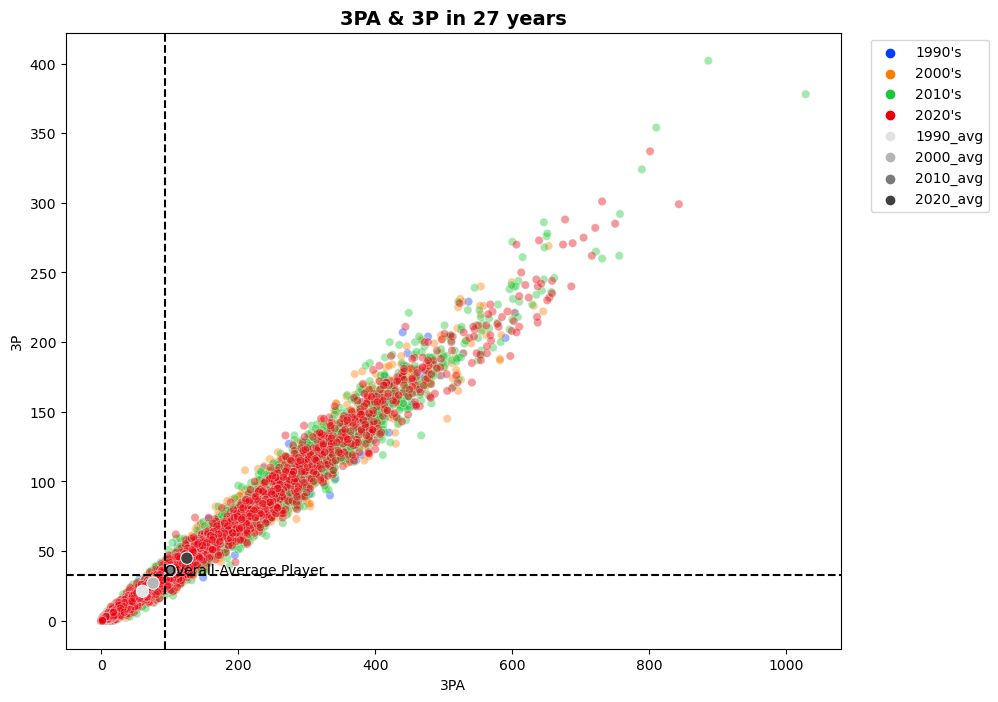

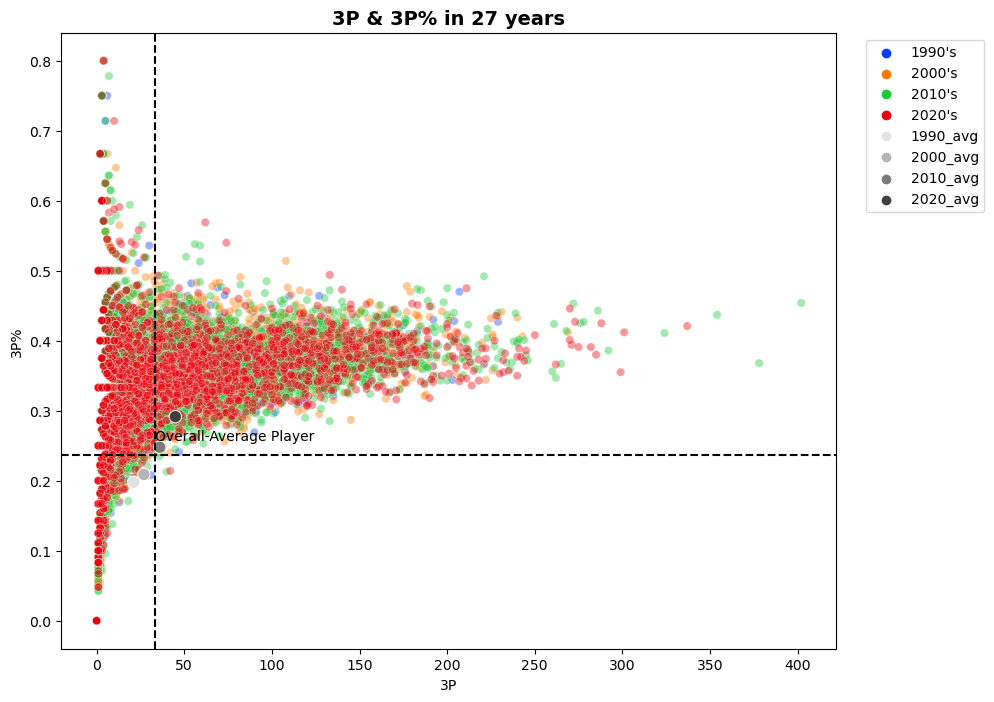

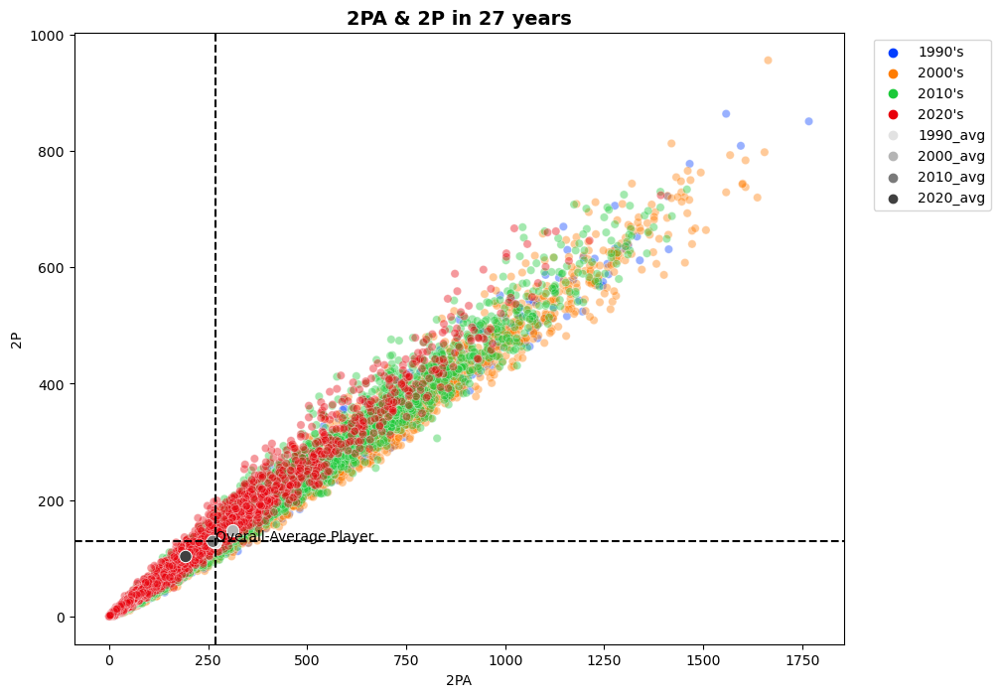

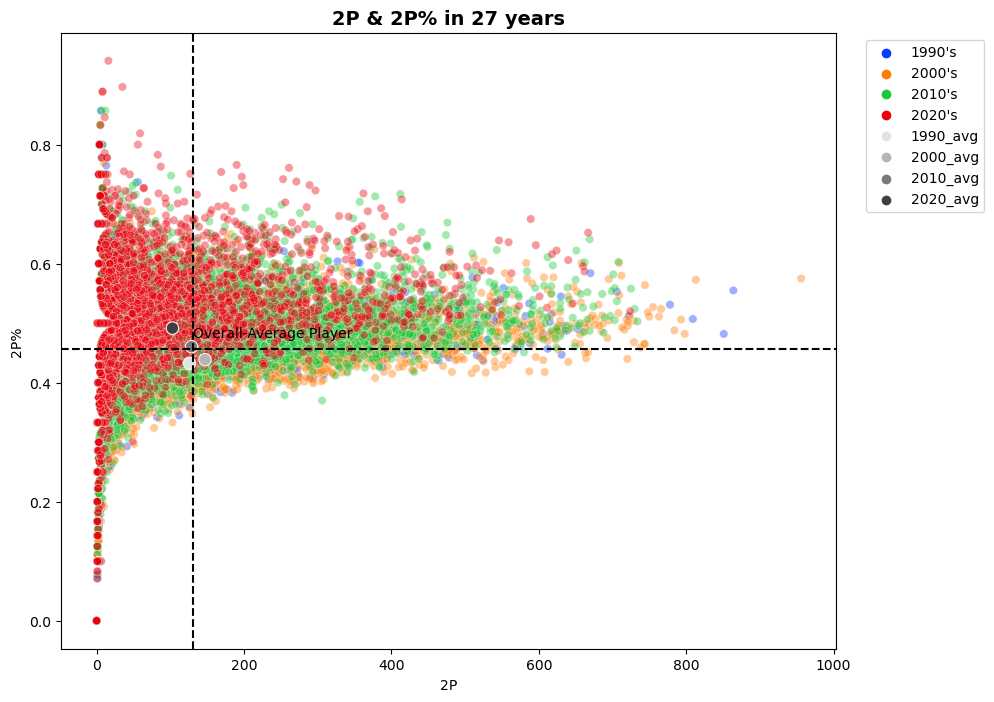

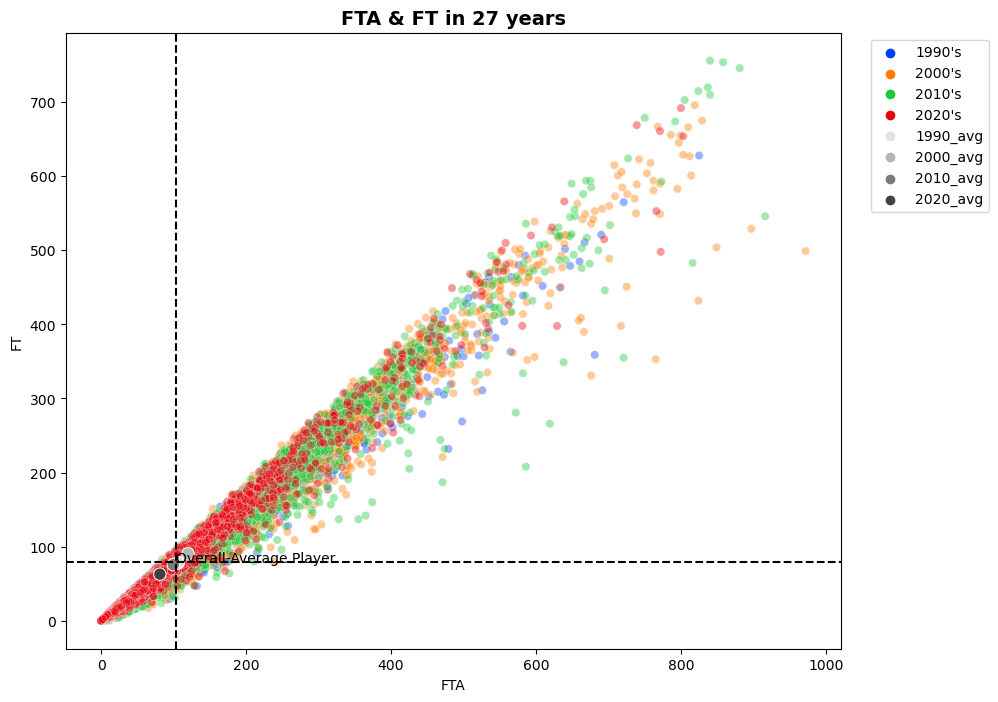

...

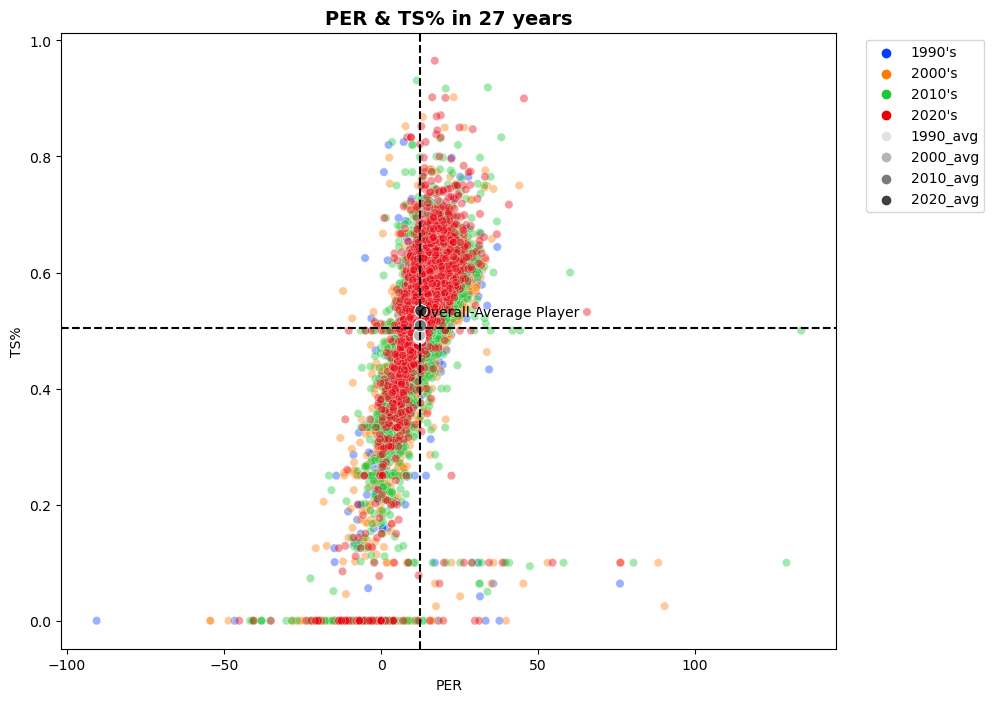

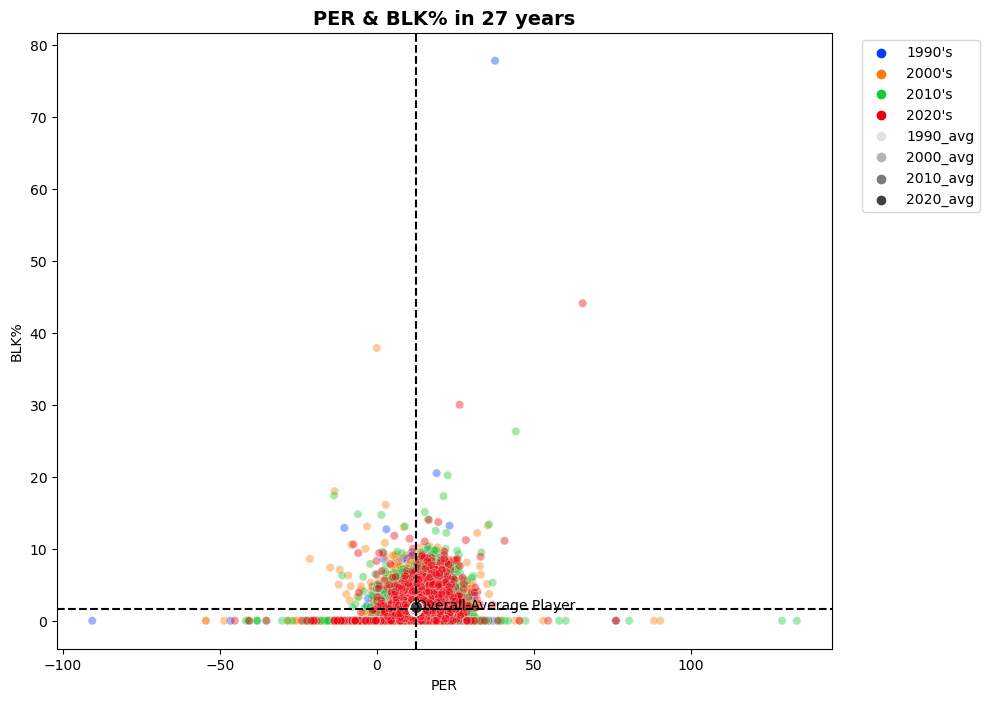

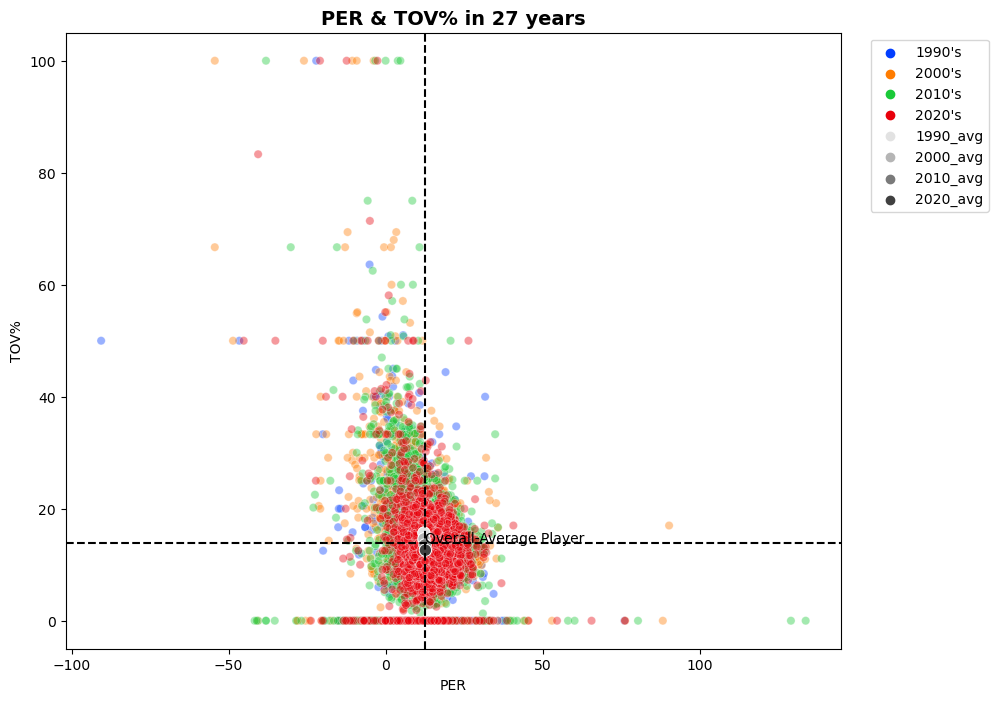

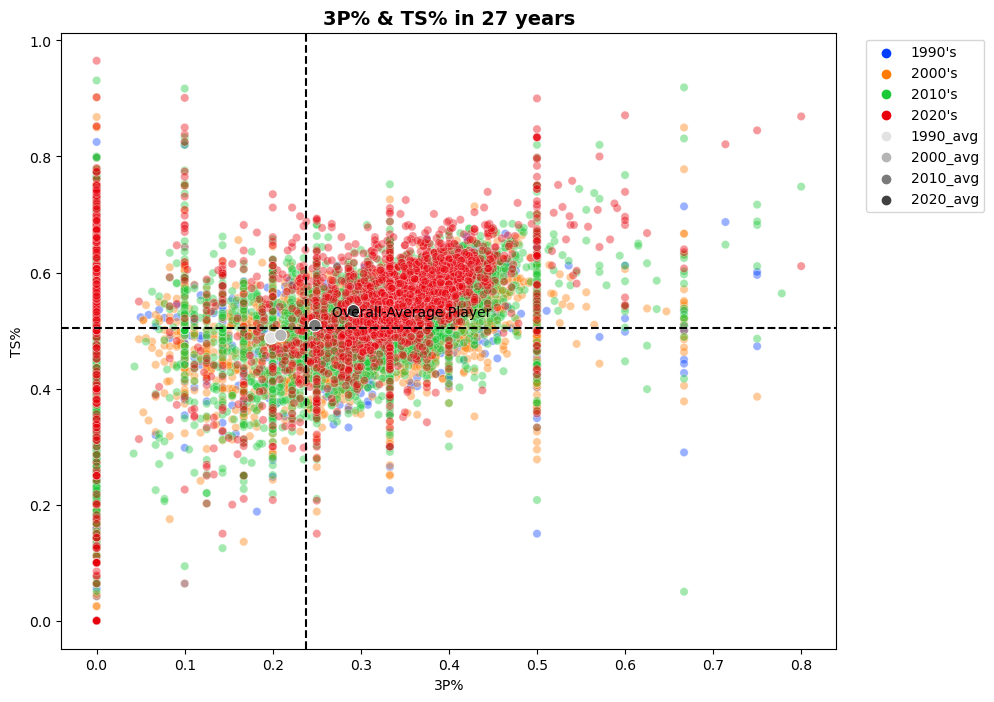

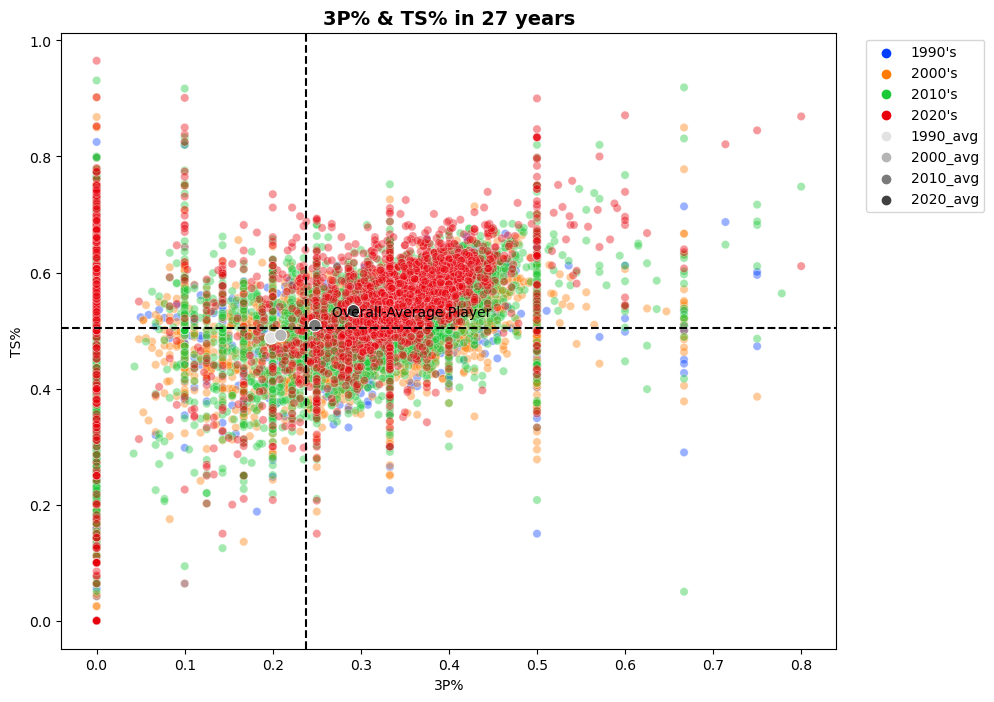

In [9]:
def decade(x):
    if x <= 1989:
        return "1980's"
    elif x>= 1990 and x <= 1999:
        return "1990's"
    elif x>= 2000 and x <= 2009:
        return "2000's"
    elif x >= 2010 and x <= 2019:
        return "2010's"
    else:
        return "2020's"

df['Decades']=df['Year'].apply(decade)
var=[['3PA','3P'],['3P','3P%'],['2PA','2P'],['2P','2P%'],['FTA','FT'],['FT','FT%'],['FG','eFG%'],['G','TS%'],['BLK','BLK%'],['TOV','TOV%'],
     ['OnCourt','On-Off'],['ORB','ORB%'],['DRB','DRB%'],['TOV','BadPass'],['TOV','LostBall'],['PER','3P%'],['PER','2P%'],
     ['PER','FT%'],['PER','eFG%'],['PER','TS%'],['PER','BLK%'],['PER','TOV%'], ['3P%','TS%'],['3P%','TS%']]

for x in var:
    plt.figure(figsize=(10,8))
    sns.scatterplot(x=df[x[0]],y=df[x[1]],hue=df['Decades'], alpha=0.4, palette='bright')
    plt.axvline(df[x[0]].mean(),ls='--',color='black')
    plt.axhline(df[x[1]].mean(),ls='--',color='black')
    plt.text(df[x[0]].mean()+0.03,df[x[1]].mean()+0.02,'Overall-Average Player')
    plt.title('{} & {} in {} years'.format(x[0],x[1], len(df['Year'].unique())), size=14, fontweight='bold')
    df_avg_stats=pd.merge(df.groupby(['Decades'])[x[0]].mean().to_frame().reset_index(),
                          df.groupby(['Decades'])[x[1]].mean().to_frame().reset_index(),
                          how='left',on='Decades')
    df_avg_stats['Decades']=df_avg_stats['Decades'].replace({"1990's":"1990_avg","2000's":"2000_avg","2010's":"2010_avg",
                                                            "2020's":"2020_avg"})
    sns.scatterplot(x=df_avg_stats[x[0]],y=df_avg_stats[x[1]],hue=df_avg_stats['Decades'], s=80, palette='Greys')
    plt.legend(bbox_to_anchor=(1.2, 1.0))

These more general visualizations allowed us to observe how the different features developed during the decades.
Here, we can make some essential observations;
- over the different decades, we can see that NBA players are taking and making more 3-pointers than they did before
- at the same time, the number of 2 pointers have decreased in the modern NBA
- another interesting aspect is that in the modern NBA (the 2010s & 2020s), players attempt fewer free throws; this could be traced back to the fact that in the modern NBA, teams play a softer defence, which leads to fewer fouls. The reduced turnover numbers support this aspect.

Next, I will check whether the features we use for the project have a normal distribution. To do this, I will display the qq-plot, which determines whether the data follows a normal distribution.

In [10]:
df.to_csv('Total_Stats_1997_2023.csv')

C:\Users\gandj\AppData\Local\Temp\ipykernel_15372\1527686039.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8,6))


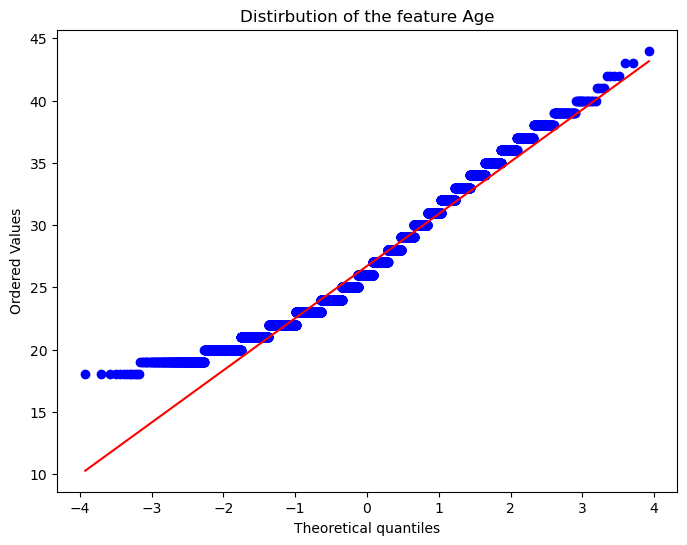

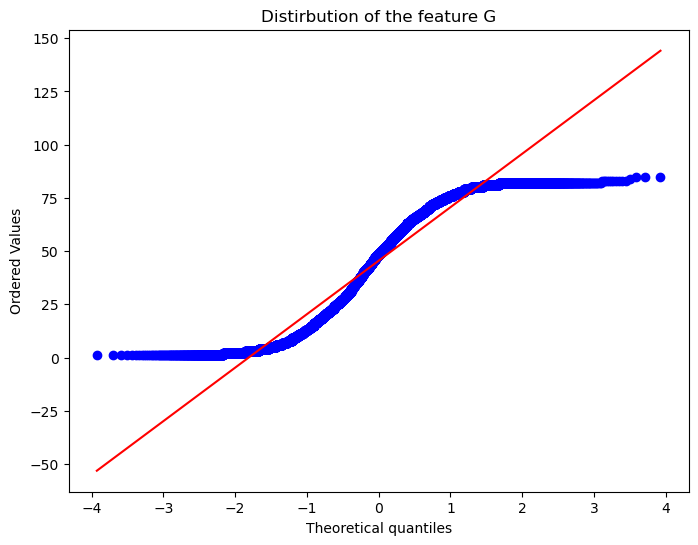

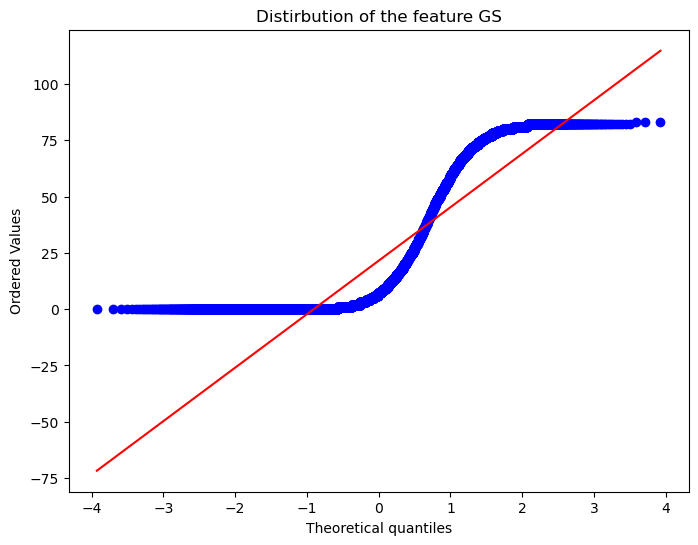

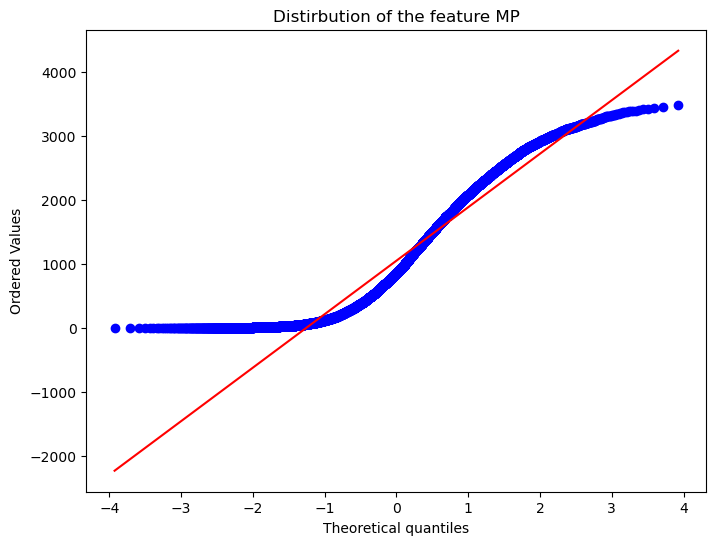

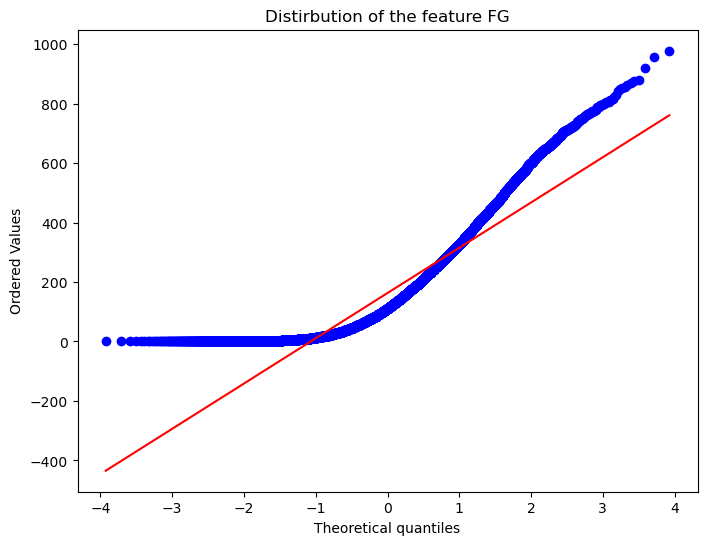

...

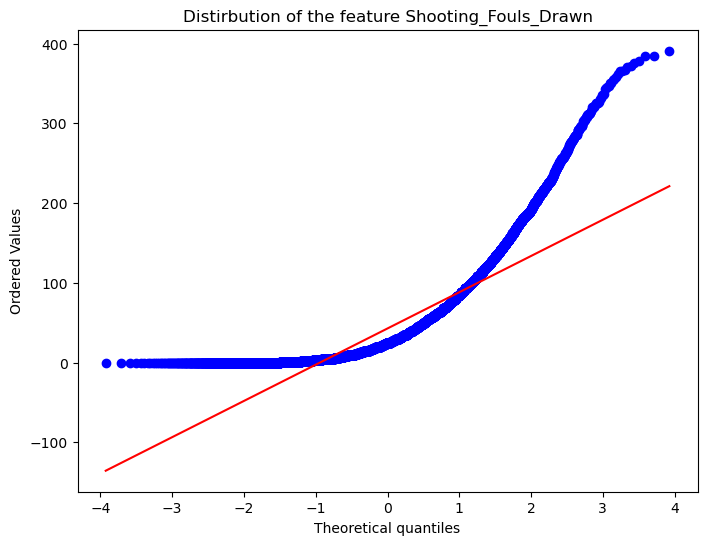

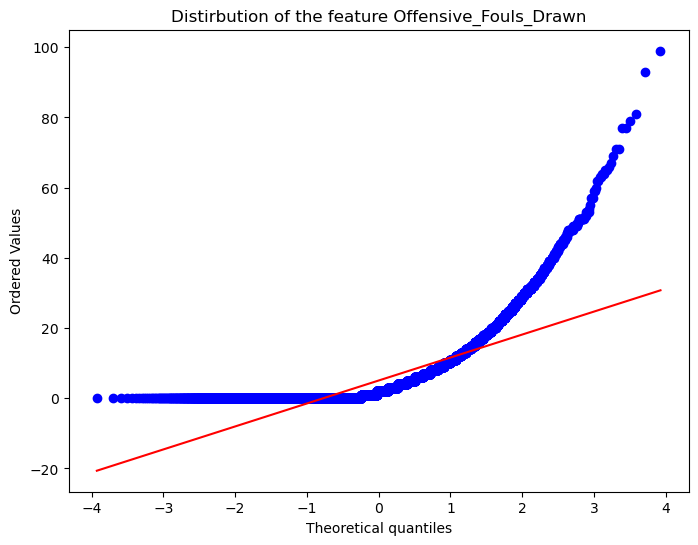

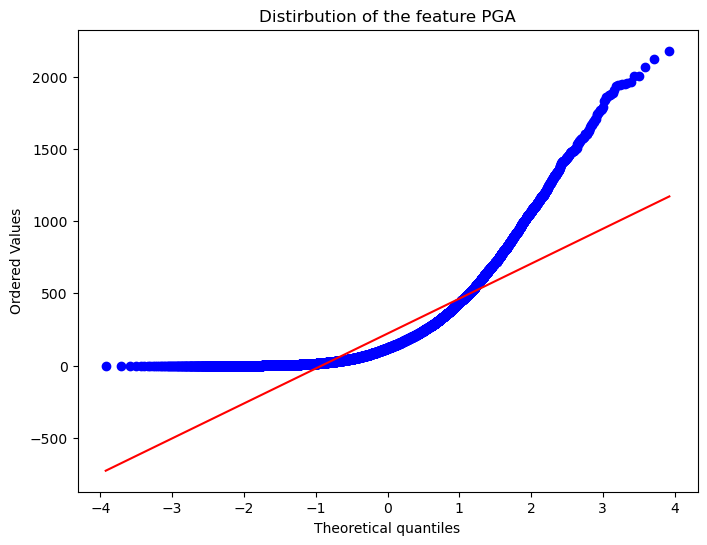

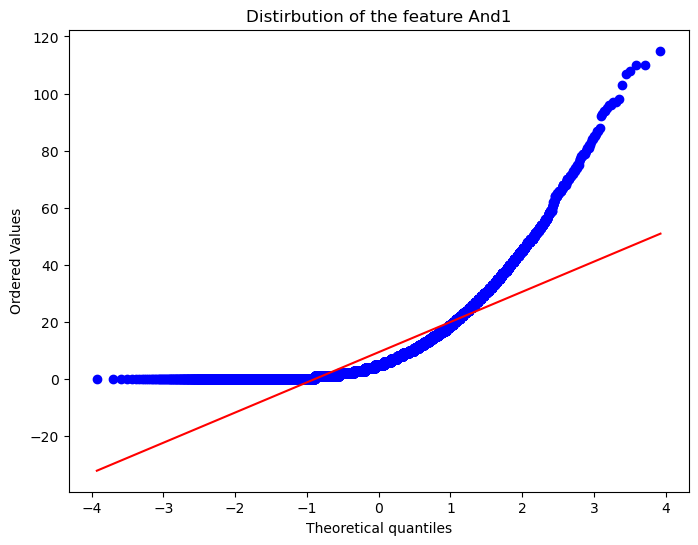

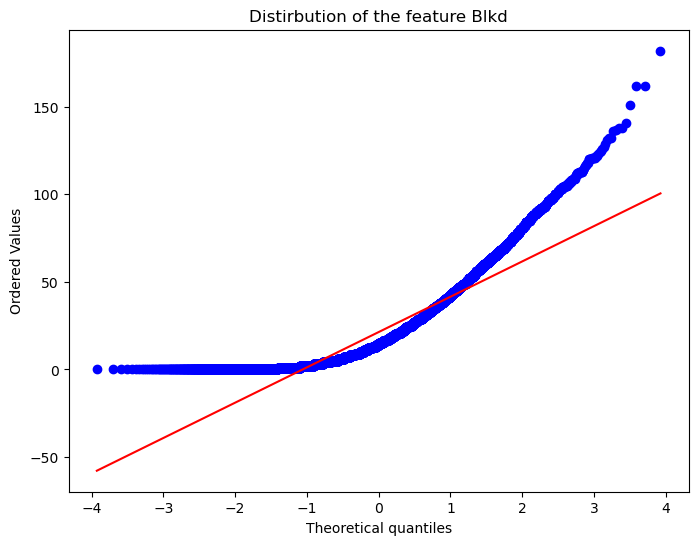

In [11]:
import scipy.stats as sm
col=list(df.columns)
del_col=["Player","Pos","Tm","Year","Starting%_float","Starting%_str","Decades","League Champion","Most Valuable Player",
        "Rookie of the Year","PPG Leader","RPG Leader","APG Leader","Win Share Leader"]
for y in del_col:
    col.remove(y)

for x in col:
    plt.figure(figsize=(8,6))
    sm.probplot(df[x],dist='norm', plot=plt)
    plt.title('Distirbution of the feature {}'.format(x))
plt.show()

Looking at the qq-plots, it becomes evident that we are dealing with non-normal distributions.
Next, I want to understand better how much the features have changed during the different decades. Therefore, I will create boxplots to showcase the developments.

C:\Users\gandj\AppData\Local\Temp\ipykernel_15372\2640298320.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(16,12))


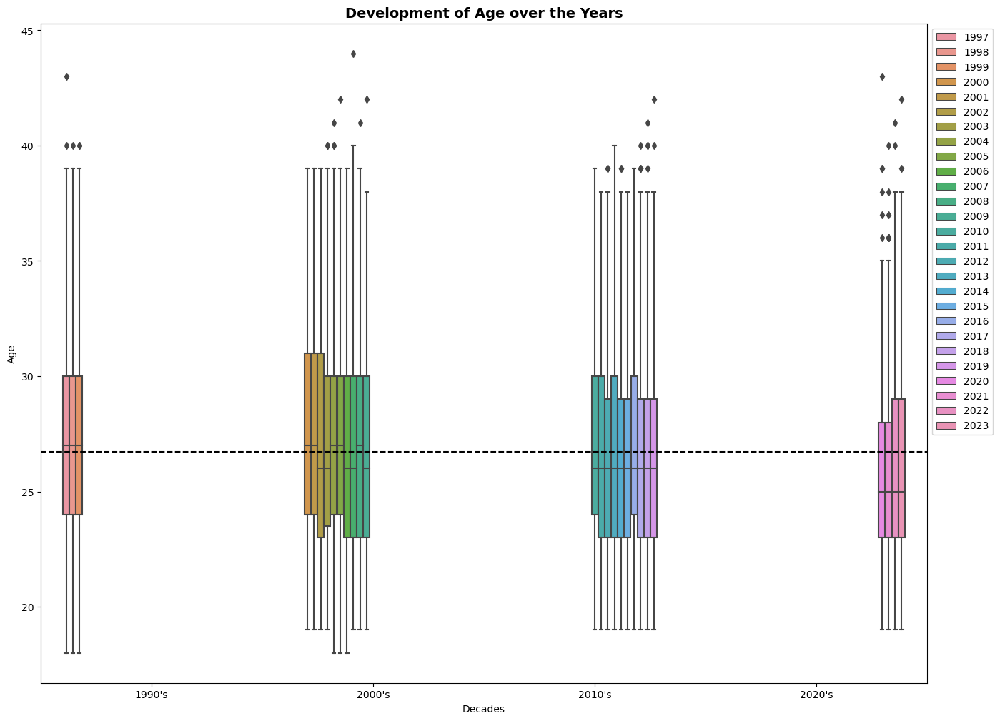

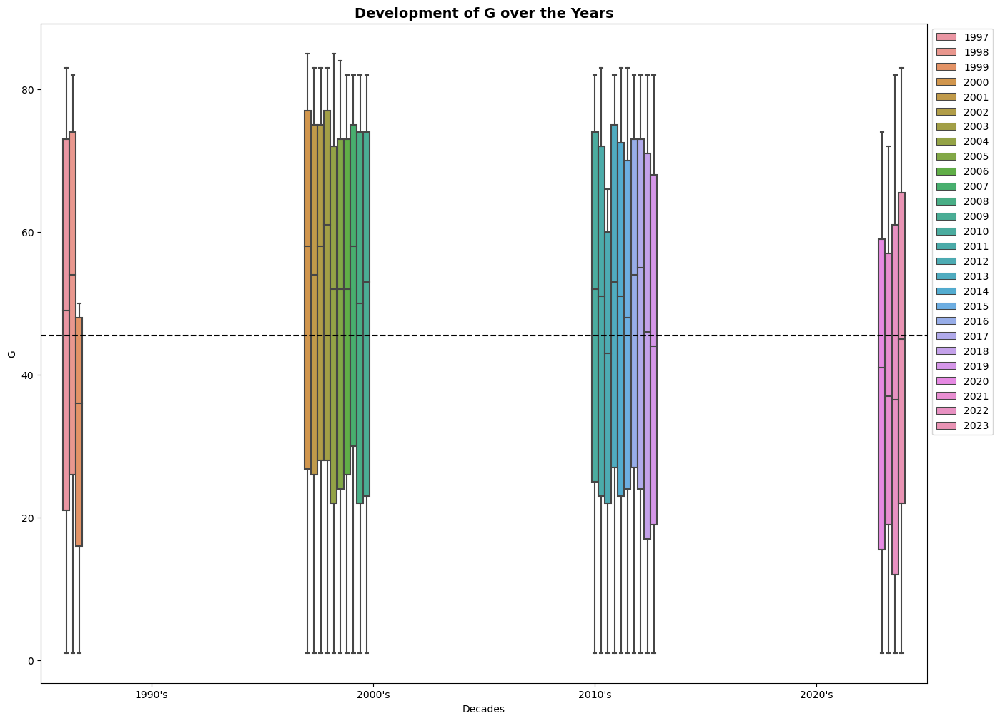

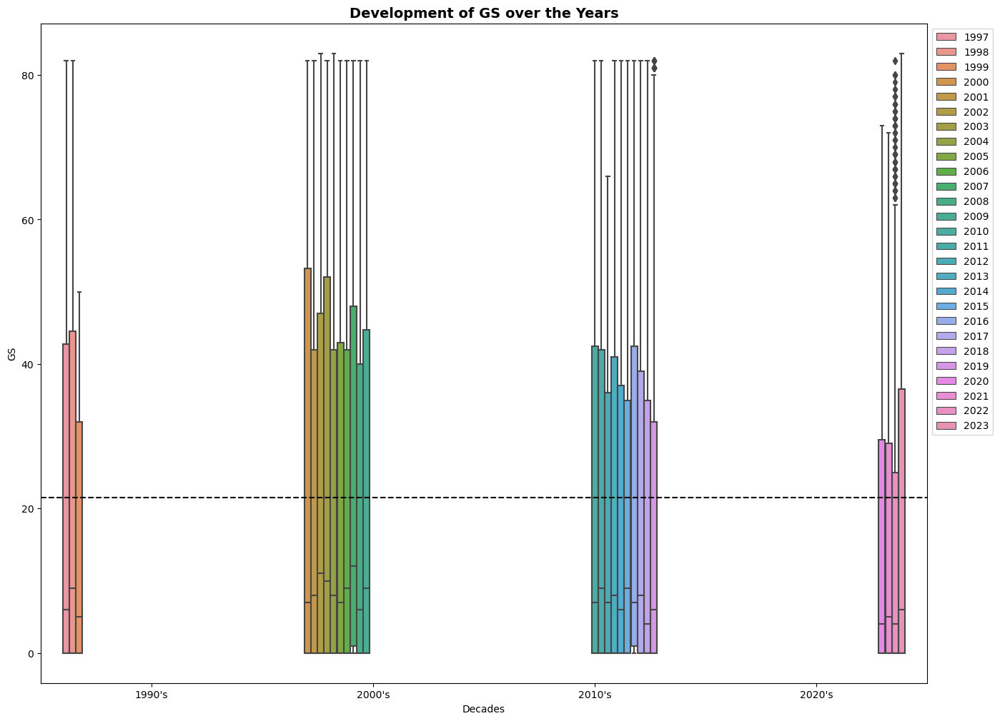

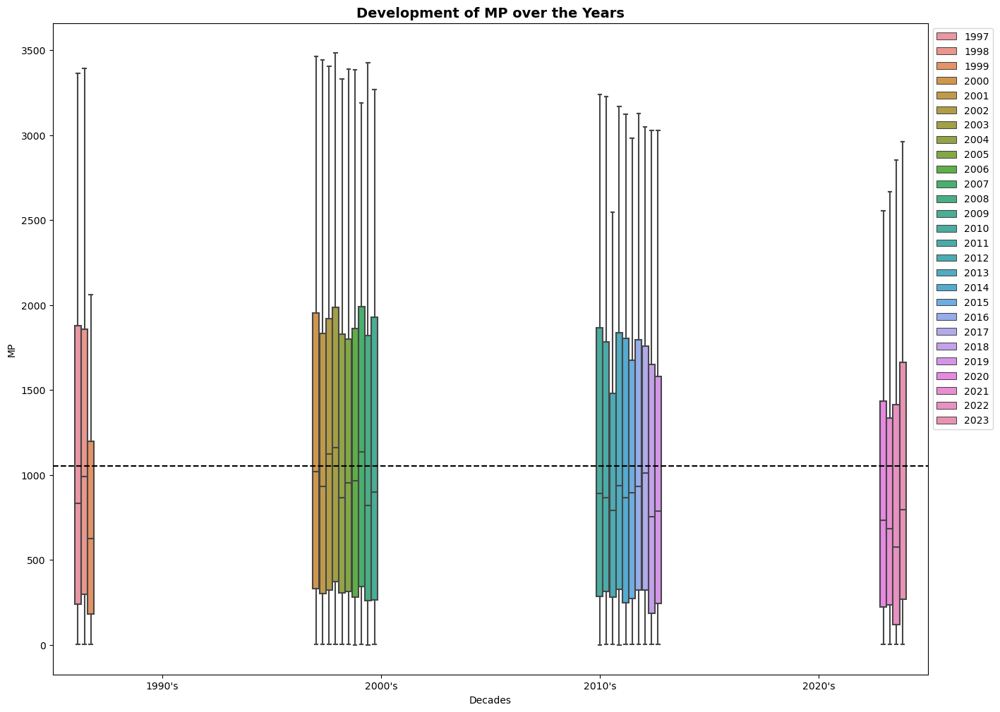

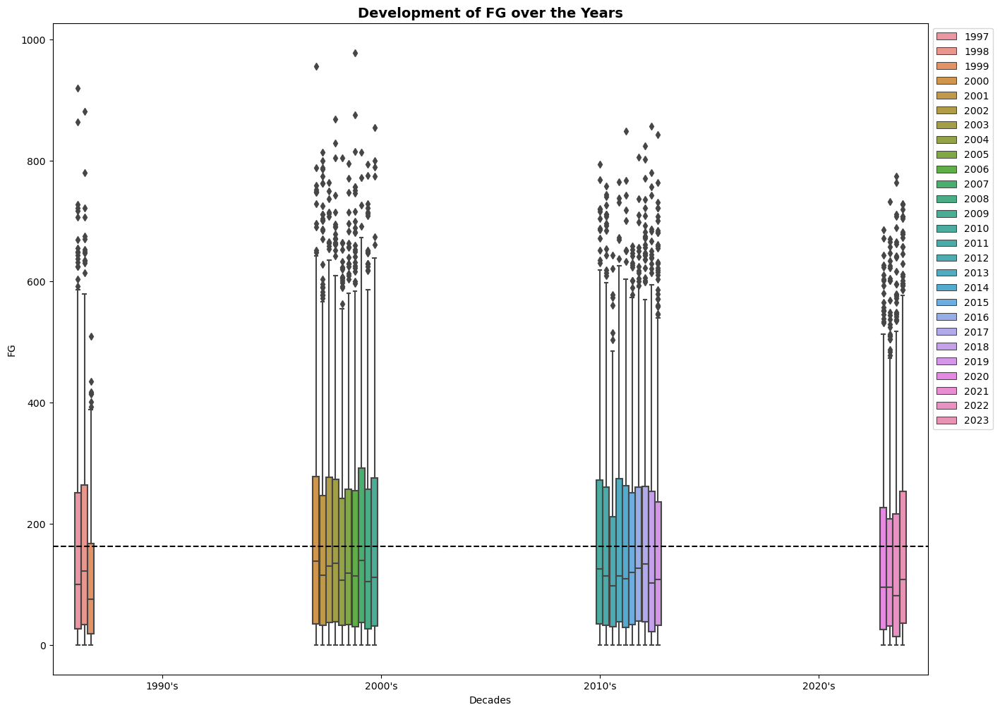

...

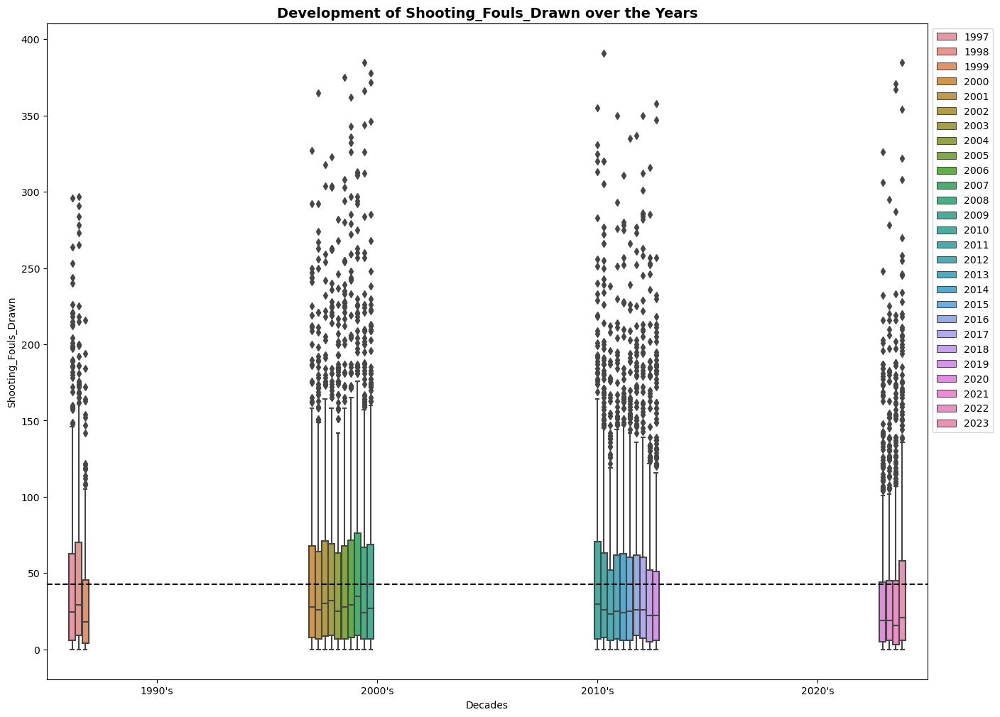

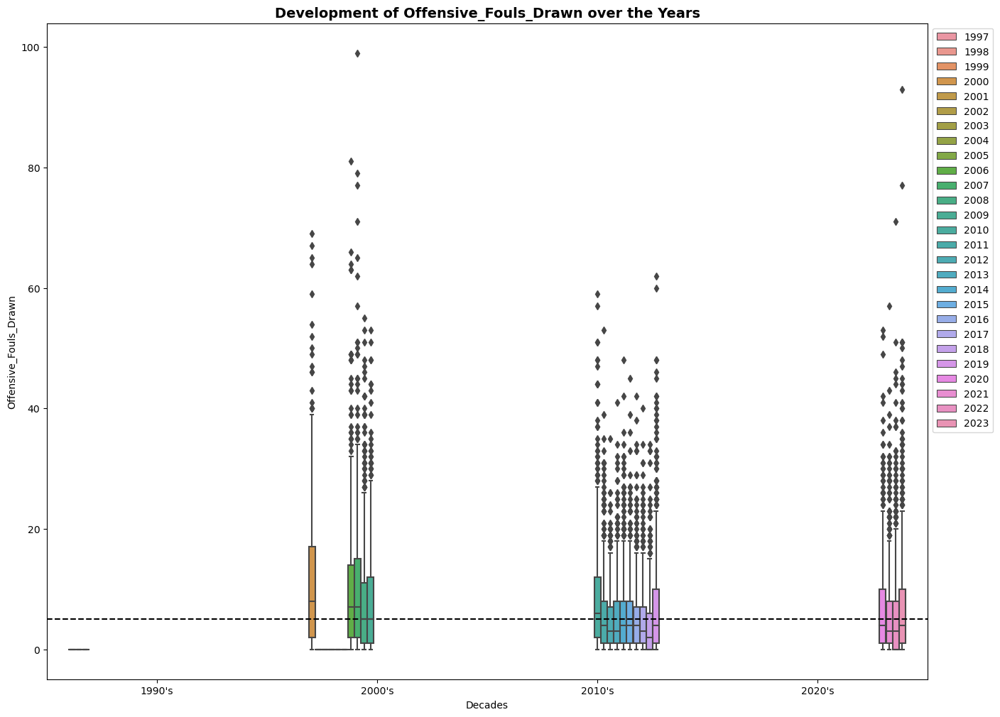

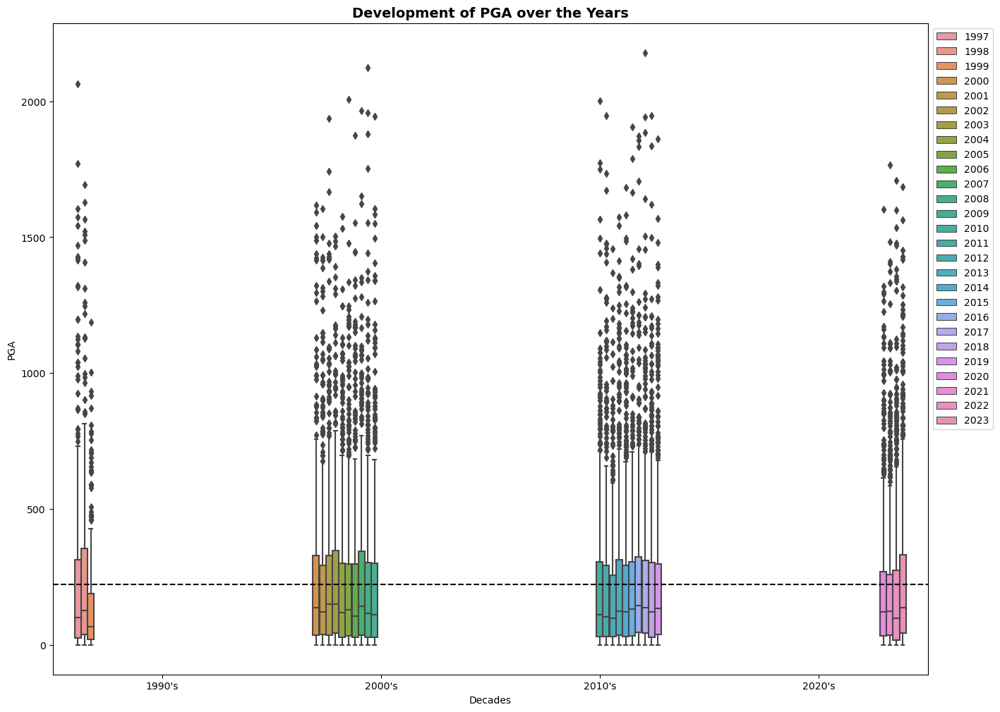

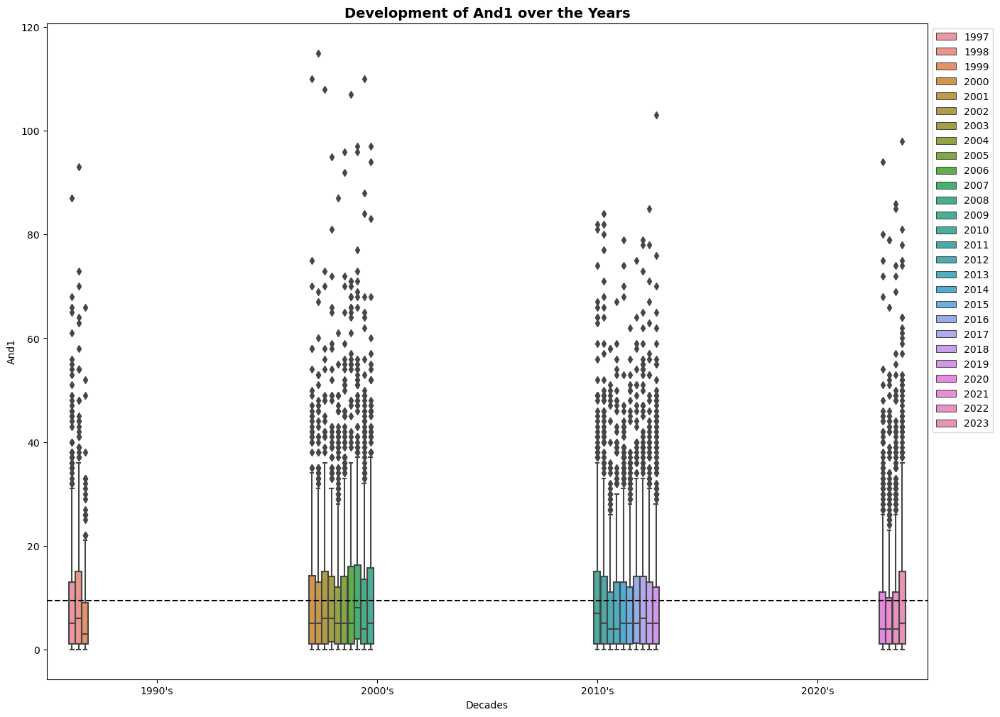

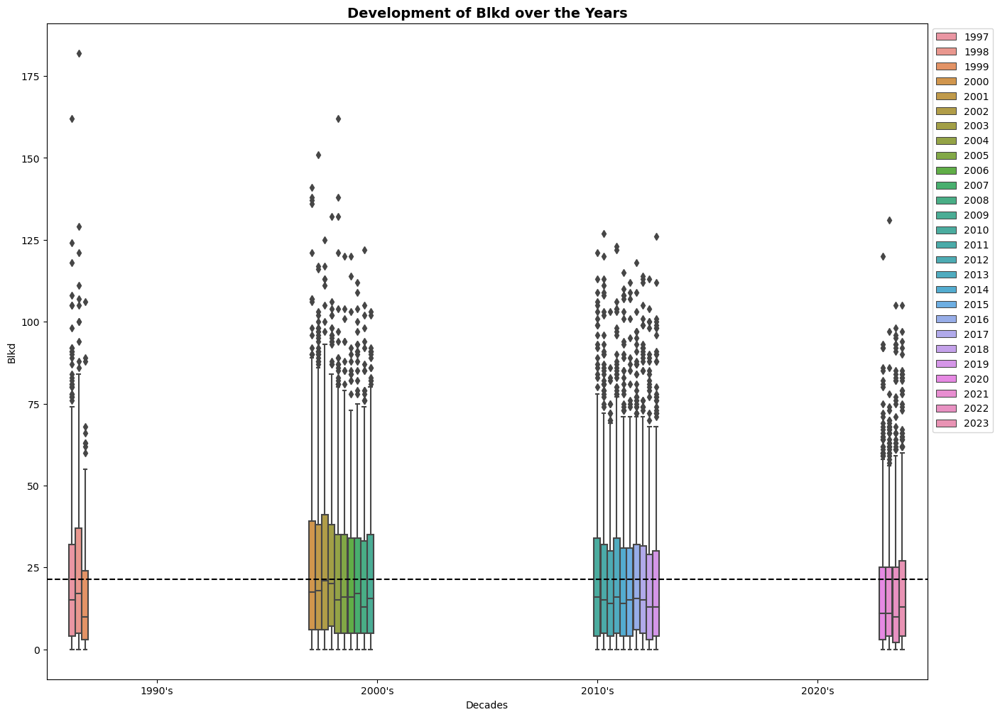

In [12]:
col=list(df.columns)
del_col=["Player","Pos","Tm","Year","Starting%_float","Starting%_str","Decades","League Champion","Most Valuable Player",
        "Rookie of the Year","PPG Leader","RPG Leader","APG Leader","Win Share Leader"]
for y in del_col:
    col.remove(y)

for x in col:
    plt.figure(figsize=(16,12))
    sns.boxplot(x=df['Decades'],y=df[x], hue=df['Year'])
    plt.axhline(df[x].mean(),ls='--',color='black')
    plt.legend(bbox_to_anchor=(1.0,1.0))
    plt.title("Development of {} over the Years".format(x), size=14, fontweight='bold')

By analysing the scatter- and boxplots, we can observe several trends:

- Over the decades, the workload has decreased. We can see that by the number of games played and games started

- In the most recent decade, the teams tend to have a much higher field goal percentage. This can be led back to the fact that in the modern NBA, scoring plays are favoured. Therefore, a "hard"/"strong" defence will be awarded with a foul. This course/policy led to high-scoring games in the modern NBA and a higher field goal percentage. This aspect is supported by the "effective field goal percentage" feature, which has increased over decades.

- Another feature supporting the "softer" defence assumption is the drastically increased true shooting percentage (TS%). Apparently, the player's shooting has improved, or the defence has gotten softer.

- Another interesting observation is that the modern NBA values 3-point shooting much more than in the past. This can be observed by the features which showcase two-point and three-point shooting (PA, P, %). Here, we can see that the numbers regarding three-point shooting have increased, and the numbers of two-point shooting has decreased. The feature "3PAr" supports our assumption. Here, we can see that the most recent decade, is attempting the most three-point shots.

After analysing the total number of players throughout the decades, I will upload the CSV with the average data I generated in the previous notebook to display each player's career performance.

## Player Season Average

In [13]:
#setting the data set up, just like we did for the total data
df_avg=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case Study\Basketball\NBA_Avg_Stats.csv").iloc[:,1:]
df_avg['Avg_MP']=round(df_avg['MP']/df_avg['G'])
df_avg=df_avg.iloc[:,[0,1,2,3,4,5,6,29,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28]]
df_avg['Tm'].replace({'SAC':'Sacramento Kings','VAN':'Vancouver Grizzlies','CHH':'Charlotte Hornets','SAS':'San Antonio Spurs',
                 'IND':'Indiana Pacers', 'DEN':'Denver Nuggets','MIL':'Milwaukee Bucks','ATL':'Atlanta Hawks','WSB':'Washington Bullets',
                 'POR':'Portland Trail Blazers','ORL':'Orlando Magic','UTA':'Utah Jazz','MIA':'Miami Heat','GSW':'Golden State Warriors',
                 'NJN':'New Jersey Nets','DET':'Detroit Pistons','HOU':'Houston Rockets','BOS':'Boston Celtics','LAC':'Los Angeles Clippers',
                 'TOR':'Toronto Raptors','LAL':'Los Angeles Lakers','PHO':'Phoenix Suns','DAL':'Dallas Mavericks','PHI':'Philadelphia 76ers',
                 'CLE':'Cleveland Cavaliers','NYK':'New York Knicks','CHI':'Chicago Bulls','MIN':'Minnesota Timberwolves','SEA':'Seattle SuperSonics',
                 'WAS':'Washington Wizards','MEM':'Memphis Grizzlies','NOH':'New Orleans Hornets','CHA':'Charlotte Bobcats','NOK':'New Orleans/Pklahoma City Hornets',
                 'OKC':'Oklahoma City Thunder','BRK':'Brooklyn Nets','NOP':'New Orleans Pelicans','CHO':'Charlotte Hornets',
                 'TOT':'more than 2 Teams'}, inplace=True)

#removing the '*' from the player name
df_avg['Player']=df_avg['Player'].apply(lambda x: x[:-1] if x[-1]=='*' else x)
df_seasonal_avg=pd.read_csv(r"C:\Users\gandj\OneDrive\Desktop\Case Study\Basketball\Season_avg_output_1984_2023.csv").iloc[:,1:]

In [14]:
df_avg=pd.merge(df_avg,df_seasonal_avg,how='left',on='Year')
cols=list(df_seasonal_avg.columns)[1:-1]
for col in cols:
    df_avg[col]=np.where(df_avg['Player']==df_avg[col],1,0)
df_avg['League Champion']=np.where(df_avg['Tm']==df_avg['League Champion'],1,0)
df_avg['Played%']=round(df_avg['G']/82,2)
df_avg['Started%']=round(df_avg['GS']/df_avg['G'],2)
df_avg['Decades']=df_avg['Year'].apply(decade)
df_avg=df_avg.iloc[:,[0,1,2,3,4,5,37,38,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,39,30,31,32,33,34,35,36]]
df_avg.head()

,Player,Pos,Age,Tm,G,GS,Played%,Started%,MP,Avg_MP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Year,Decades,League Champion,Most Valuable Player,Rookie of the Year,PPG Leader,RPG Leader,APG Leader,Win Share Leader
0,Kareem Abdul-Jabbar,C,36,Los Angeles Lakers,80,80,0.98,1.00,2622,33.0,9.8,17.0,0.578,0.0,0.0,0.000,9.8,17.0,0.579,3.9,5.4,0.723,2.3,5.7,8.1,2.9,0.8,2.0,3.0,2.9,23.6,1984,1980's,0,0,0,0,0,0,0
1,Alvan Adams,C,29,Phoenix Suns,70,13,0.85,0.19,1452,21.0,6.7,14.4,0.462,0.0,0.1,0.000,6.7,14.3,0.465,3.3,4.0,0.825,2.9,5.0,7.9,5.4,1.8,0.8,2.9,4.8,16.6,1984,1980's,0,0,0,0,0,0,0
2,Mark Aguirre,SF,24,Dallas Mavericks,79,79,0.96,1.00,2900,37.0,11.5,21.9,0.524,0.2,0.7,0.268,11.3,21.2,0.532,5.8,7.7,0.749,2.0,3.8,5.8,4.4,1.0,0.3,3.5,3.1,28.9,1984,1980's,0,0,0,0,0,0,0
3,Danny Ainge,SG,24,Boston Celtics,71,3,0.87,0.04,1154,16.0,5.2,11.3,0.460,0.2,0.7,0.273,5.0,10.6,0.472,1.4,1.7,0.821,0.9,2.7,3.6,5.1,1.3,0.1,2.2,4.5,12.0,1984,1980's,1,0,0,0,0,0,0
4,J.J. Anderson,SF,23,Utah Jazz,48,0,0.59,0.00,311,6.0,6.4,15.0,0.423,0.0,0.3,0.000,6.4,14.7,0.433,1.4,3.4,0.414,4.4,2.9,7.3,2.5,1.7,1.0,2.3,3.2,14.1,1984,1980's,0,0,0,0,0,0,0


In [15]:
print("The data set contains {} unique Player".format(len(df_avg['Player'].unique())))

The Data set contains 3249 unique Player


In [16]:
#first def function, which allows us to set up the player stats for all the seasons that the player played
def player_avg_state(player_name):
    player_stat=df_avg[(df_avg['Player']==player_name) & (df_avg['Tm']!="more than 2 Teams")][['Tm','Year','G','GS','Played%','Started%','Avg_MP','PTS','FG%','3P%','2P%','FT%','AST','TRB','ORB','DRB','STL','BLK',
                                        'PF','TOV','League Champion','Most Valuable Player','Rookie of the Year','PPG Leader','RPG Leader','APG Leader',
                                        'Win Share Leader']].set_index(
        df_avg[(df_avg['Player']==player_name) & (df_avg['Tm']!="more than 2 Teams")]['Player'])

    player_stat.loc['Total',:]=[len(df_avg[(df_avg['Player']==player_name) & (df_avg['Tm']!="more than 2 Teams")]['Tm'].unique()),round(len(player_stat['Year'].unique())),round(np.mean(player_stat['G'])),round(np.mean(player_stat['GS'])),
                                round(np.mean(player_stat['Played%']),2),round(np.mean(player_stat['Started%']),2),round(np.mean(player_stat['Avg_MP']),2),round(np.mean(player_stat['PTS'])),round(np.mean(player_stat['FG%']),2),round(np.mean(player_stat['3P%']),2),
                                round(np.mean(player_stat['2P%']),2),round(np.mean(player_stat['FT%']),2),round(np.mean(player_stat['AST']),2),round(np.mean(player_stat['TRB']),2),
                               round(np.mean(player_stat['ORB']),2),round(np.mean(player_stat['DRB']),2),round(np.mean(player_stat['STL']),2),round(np.mean(player_stat['BLK']),2),
                               round(np.mean(player_stat['PF']),2),round(np.mean(player_stat['TOV']),2),sum(player_stat['League Champion']),sum(player_stat['Most Valuable Player']),sum(player_stat['Rookie of the Year']),
                               sum(player_stat['PPG Leader']),sum(player_stat['RPG Leader']),sum(player_stat['APG Leader']),sum(player_stat['Win Share Leader'])]
    return player_stat

In [17]:
#the second def function allows us to color all graphics according to all the teams the player played for
def team_colors(name):
    team_colors={'Sacramento Kings':['#A020F0','Purpel'],'Vancouver Grizzlies':['#00FFFF','brown'],'Charlotte Hornets':['#A020F0','blue'],
                'San Antonio Spurs':['#000000','gray'], 'Indiana Pacers':['#0000FF','gold'],'Denver Nuggets':['#daa520','goldenrod'],
                'Milwaukee Bucks':['#006400','burlywood'],'Atlanta Hawks':['#DC143C','moccasin'], 'Washington Bullets':['#DC143C','midnightblue'],
                'Portland Trail Blazers':['gray','darkred'],'Orlando Magic':['dodgerblue','black'],'Utah Jazz':['purpel','deepskyblue'],
                'Miami Heat':['#DC143C','darkorgange'],'Golden State Warriors':['#FFD700','mediumblue'],'New Jersey Nets':['#fa8072','gray'],
                'Detroit Pistons':['#D2042D','blue'],'Houston Rockets':['#FF0000','bisque'],'Boston Celtics':['#00ff00','gold'],'Los Angeles Clippers':['#0041C2','tan'],
                'Toronto Raptors':['#FF0000','black'],'Los Angeles Lakers':['#552583','gold'],'Phoenix Suns':['#a020f0','darkorange'],'Dallas Mavericks':['#4169E1','gray'],
                'Philadelphia 76ers':['#DC143C','blue'], 'Cleveland Cavaliers':['#a52a2a','brown'],'New York Knicks':['#ff8c00', 'darkorange'],
                'Chicago Bulls':['#DC143C','black'],'Minnesota Timberwolves':['#228b22','black'],'Seattle SuperSonics':['#228b22','gold'],
                'Washington Wizards':['#D2042D','midnightblue'],'Memphis Grizzlies':['#1F456E','gray'],'New Orleans Hornets':['#1520A6','dodgerblue'],
                'Charlotte Bobcats':['#ffa500','dodgerblue'],'New Orleans/Pklahoma City Hornets':['#000000'],'Oklahoma City Thunder':['#1E90FF','orange'],
                'Brooklyn Nets':['#D3D3D3','gray'],'New Orleans Pelicans':['#ffd700','darkblue']}
    output=[]
    for x in list(player_avg_state(name).iloc[:-1,:]['Tm'].unique()):
        output.append(team_colors[x][0])
    return output

In [19]:
#third def function, here we combine all previous def functions and create for all columns a graph and how each
#season differentiates itself from the other
def nba_player_stats(Player):
    df_play=player_avg_state(Player)
    df_player=df_play.iloc[:-1,:-7]
    cols=list(df_player.columns[2:])

    #showcasting player stats with barplots and how their numbers have in-/decreased over the different seasons
    for col in cols:
        plt.figure(figsize=(12,8))
        #plt.subplot(2,1,1)
        cust_color=sns.set_palette(sns.color_palette(team_colors(Player)))
        ax=sns.barplot(x=df_player['Year'].astype(int), y=df_player[col],hue=df_player['Tm'],palette=cust_color)
        for x in ax.containers:
            ax.bar_label(x,)
        plt.legend(bbox_to_anchor=(1.0,1.0))
        plt.title('Avg {} in the Career of {}'.format(col,df_player.reset_index()['Player'][0]))
        plt.show()

        plt.figure(figsize=(12,8))
        #plt.subplot(2,1,2)
        ax2=sns.barplot(x=df_player['Year'].astype(int), y=df_player[col].diff(),hue=df_player['Tm'])
        for k in ax2.containers:
            ax2.bar_label(k,)
        plt.legend(bbox_to_anchor=(1.0,1.0))
        plt.title('{} Fluctuation in the Career of {}'.format(col,df_player.reset_index()['Player'][0]))
        plt.show()

        plt.suptitle('{}'.format(df_player.reset_index()[col][0]))
        plt.show()
    
    #showcasting awards of the athletes with an radar plot
    df_awards=player_avg_state(Player).iloc[-1,-7:].to_frame().reset_index().rename(columns={'index':'Awards'})
    fig=px.line_polar(df_awards,r='Total',theta='Awards',line_close=True,title='Career Awards of {}'.format(Player))
    fig.show()

Please enter the players name: Kobe Bryant


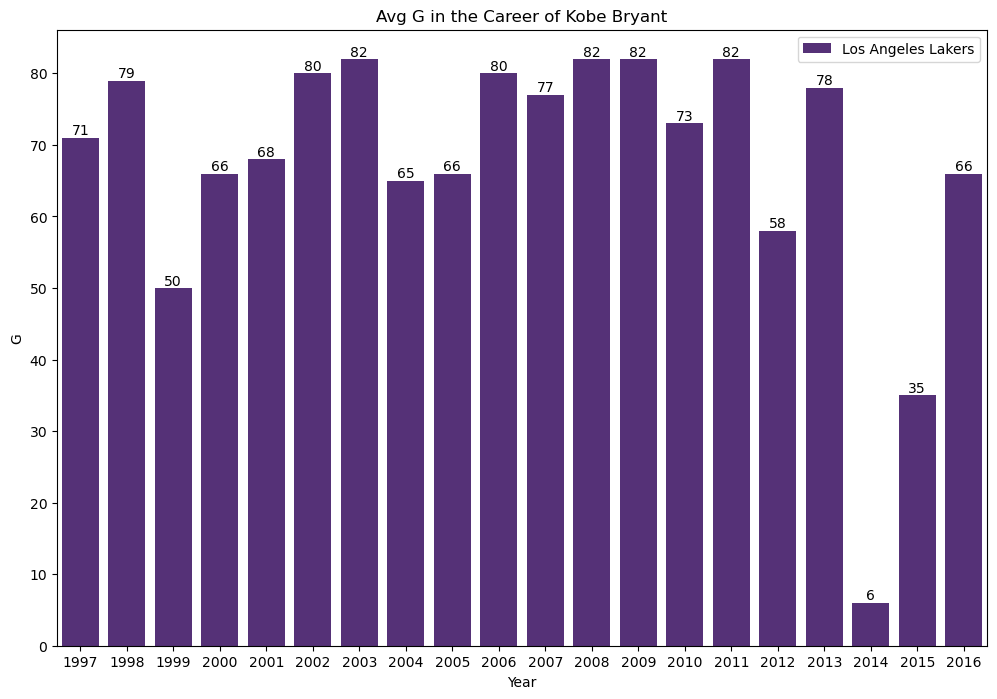

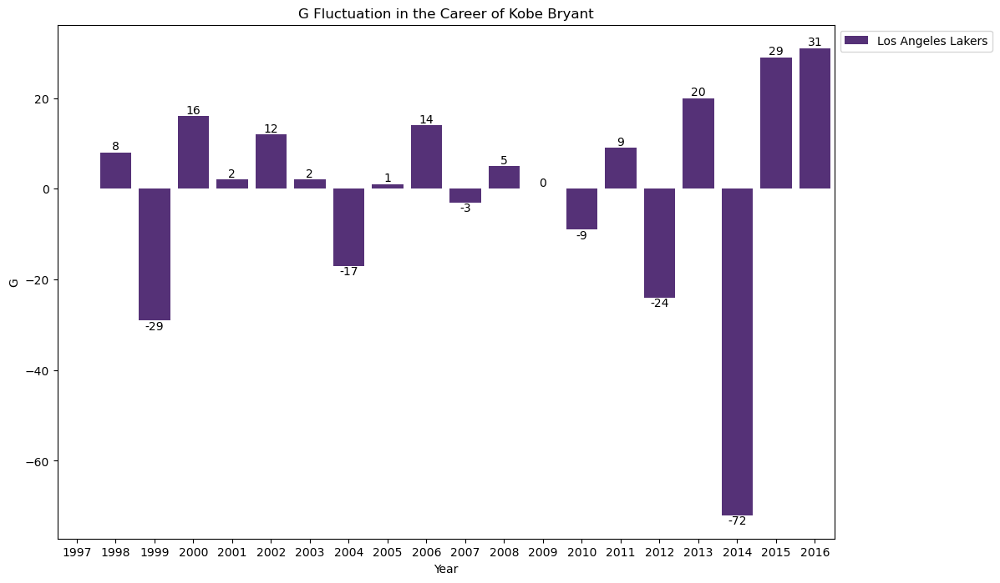

<Figure size 640x480 with 0 Axes>

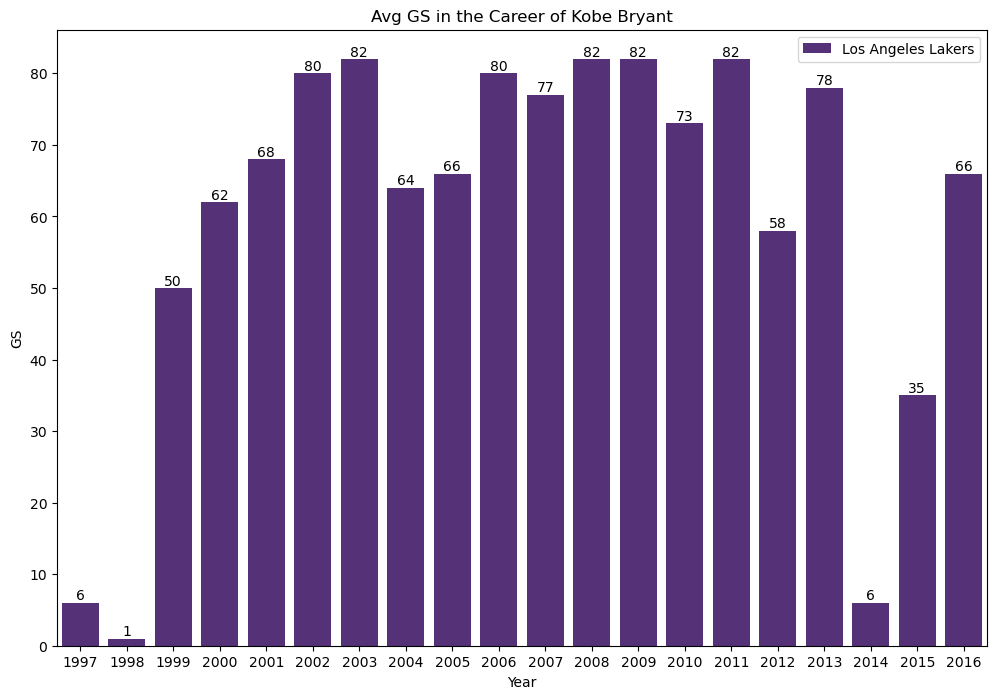

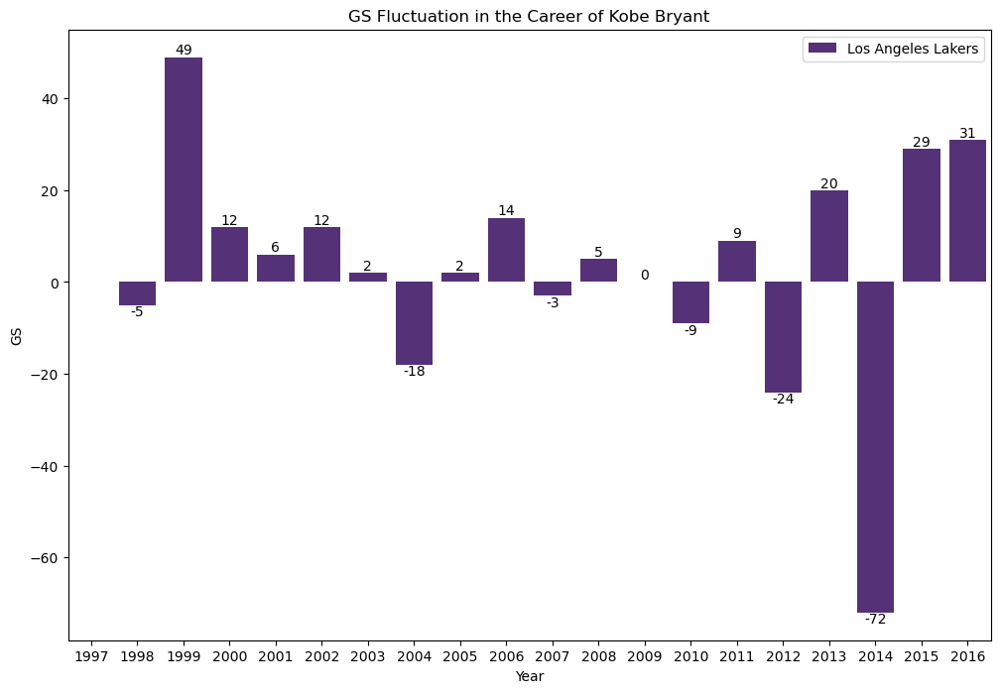

<Figure size 640x480 with 0 Axes>

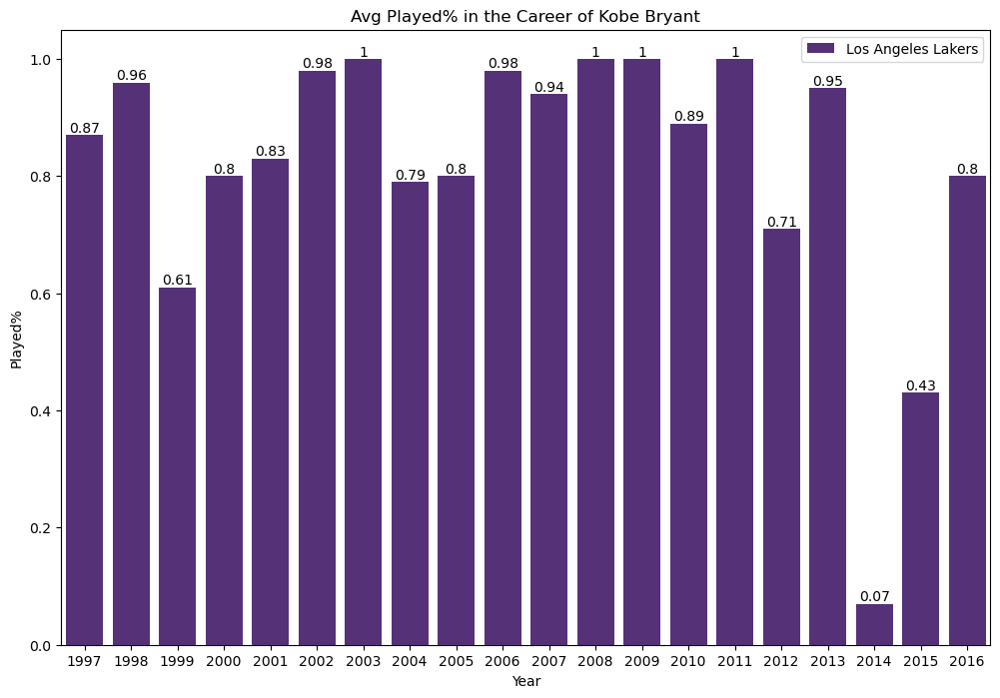

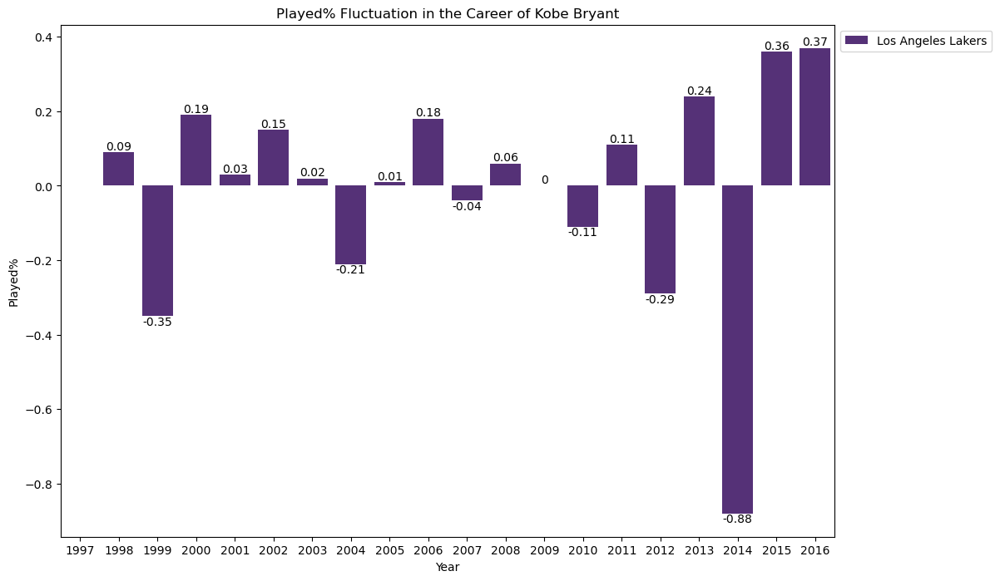

<Figure size 640x480 with 0 Axes>

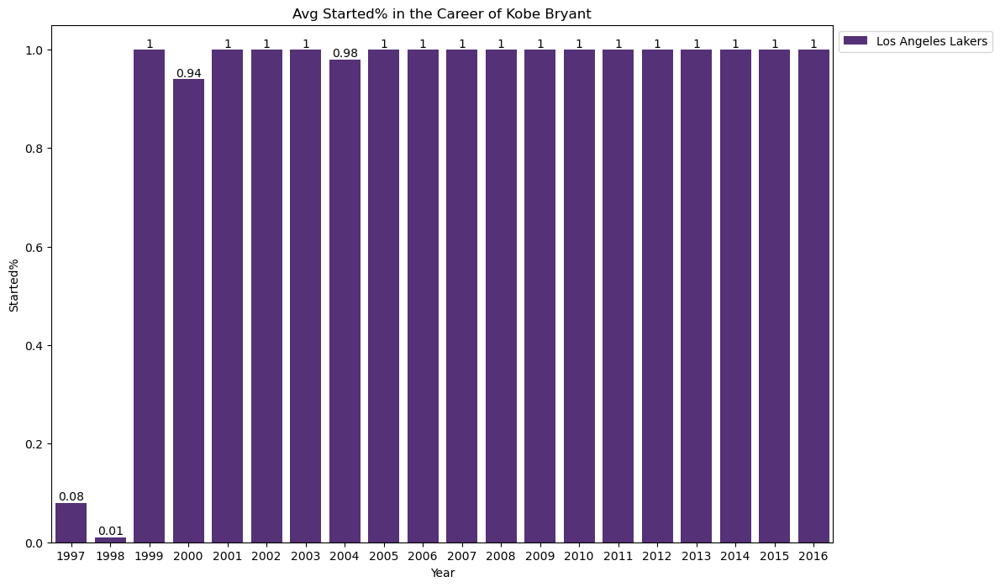

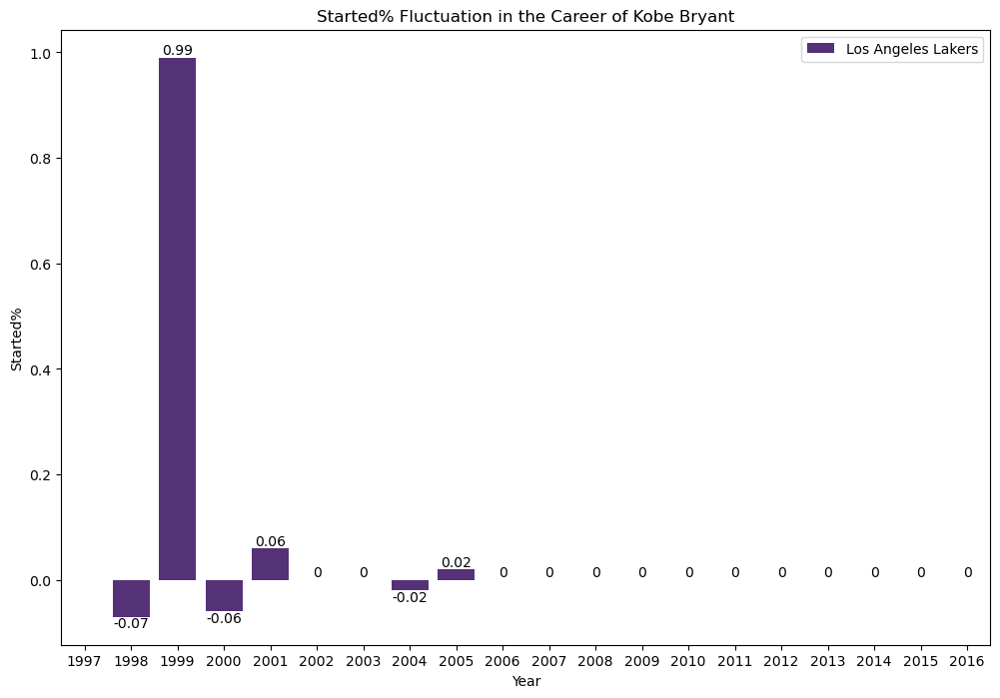

<Figure size 640x480 with 0 Axes>

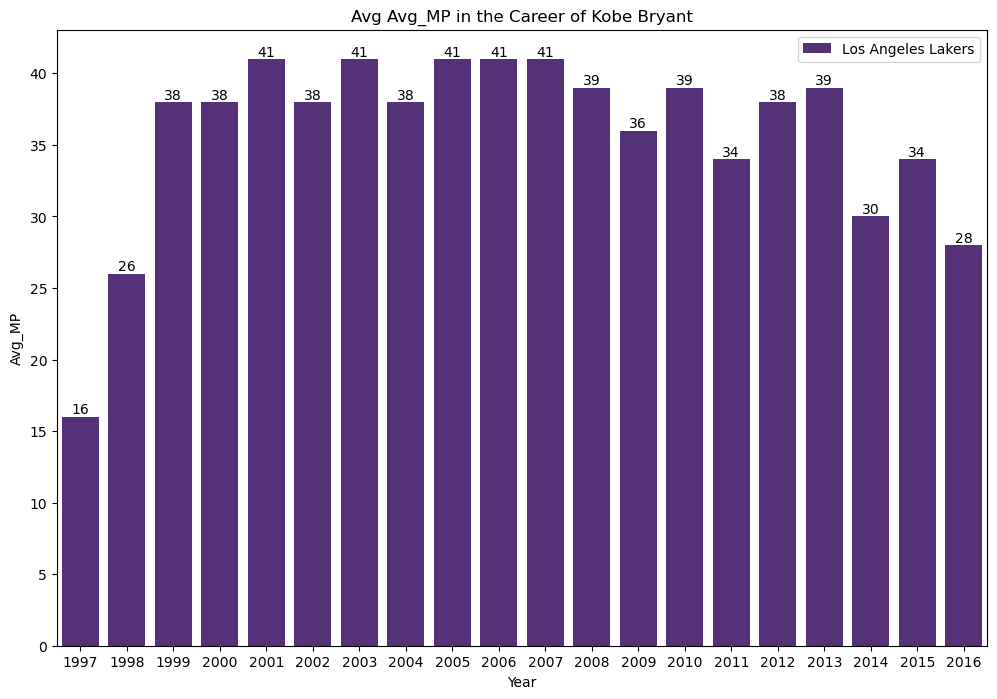

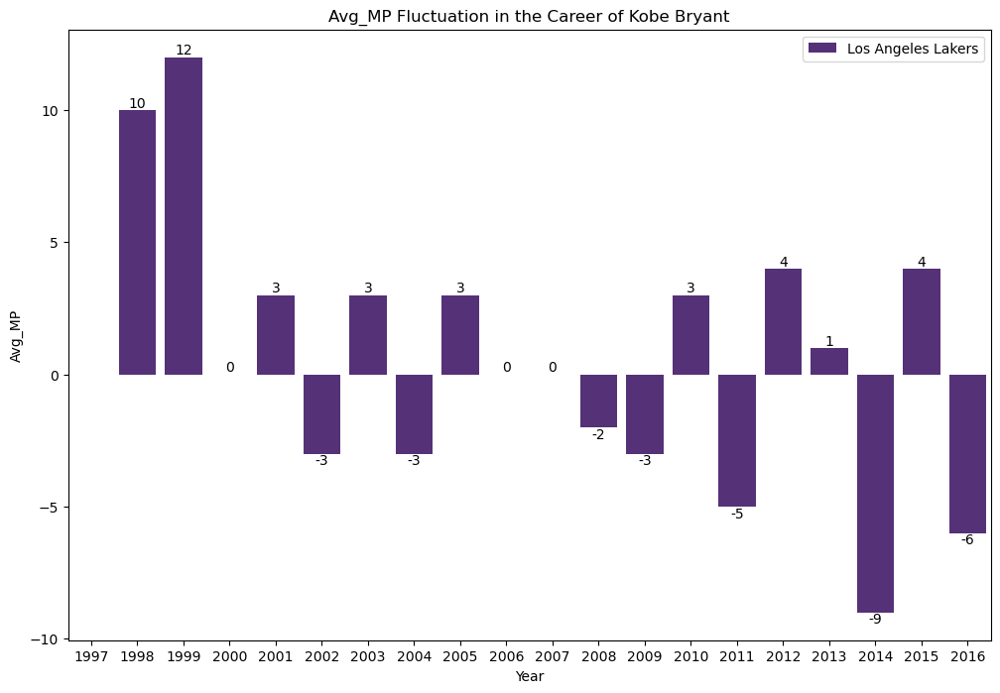

<Figure size 640x480 with 0 Axes>

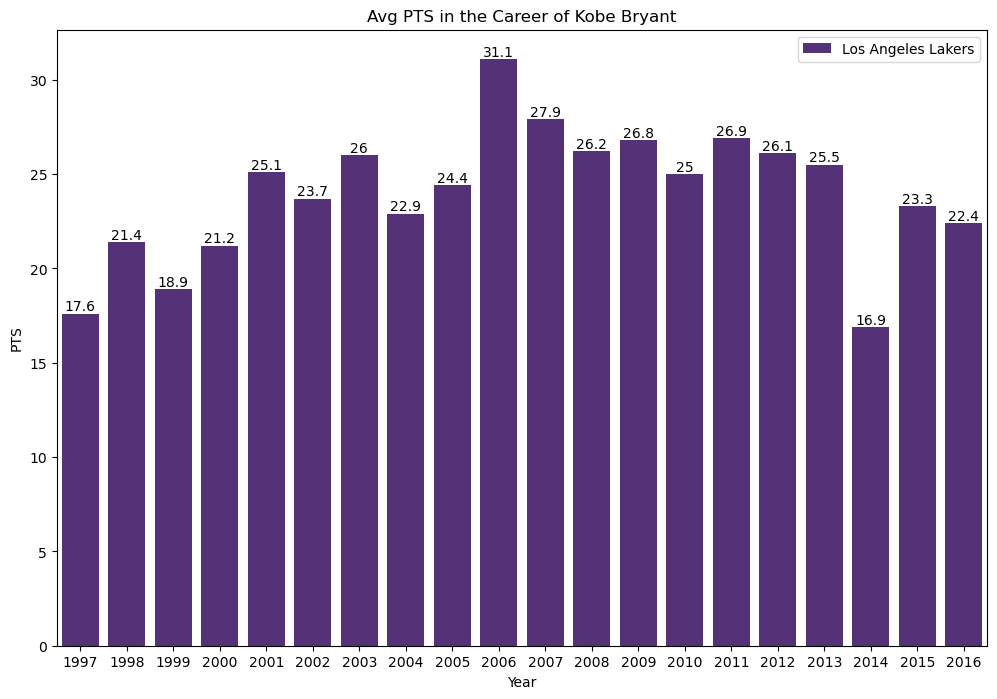

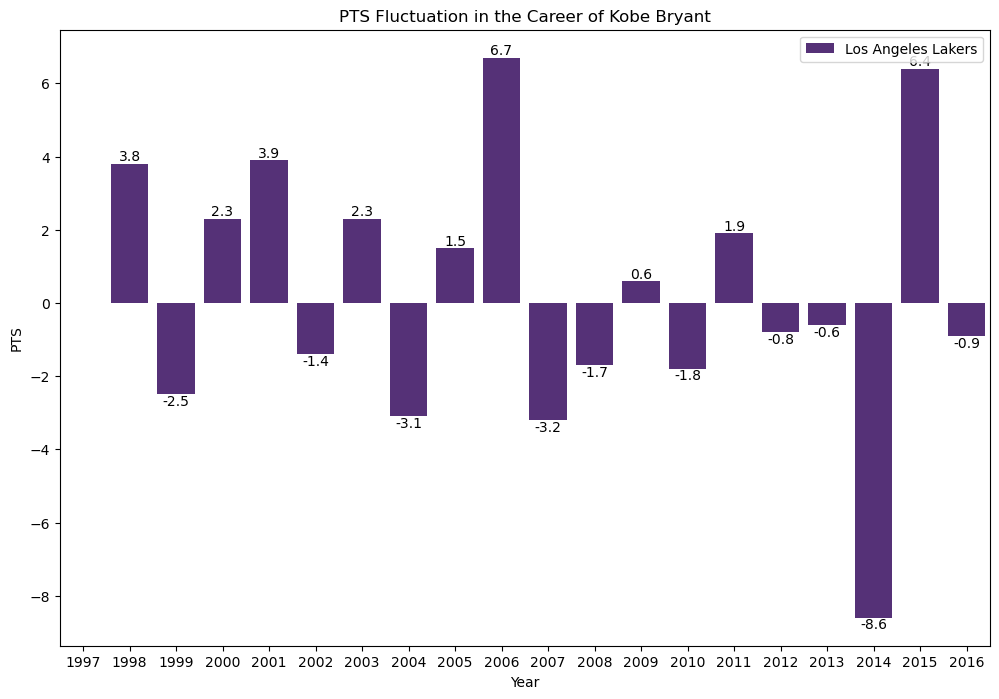

<Figure size 640x480 with 0 Axes>

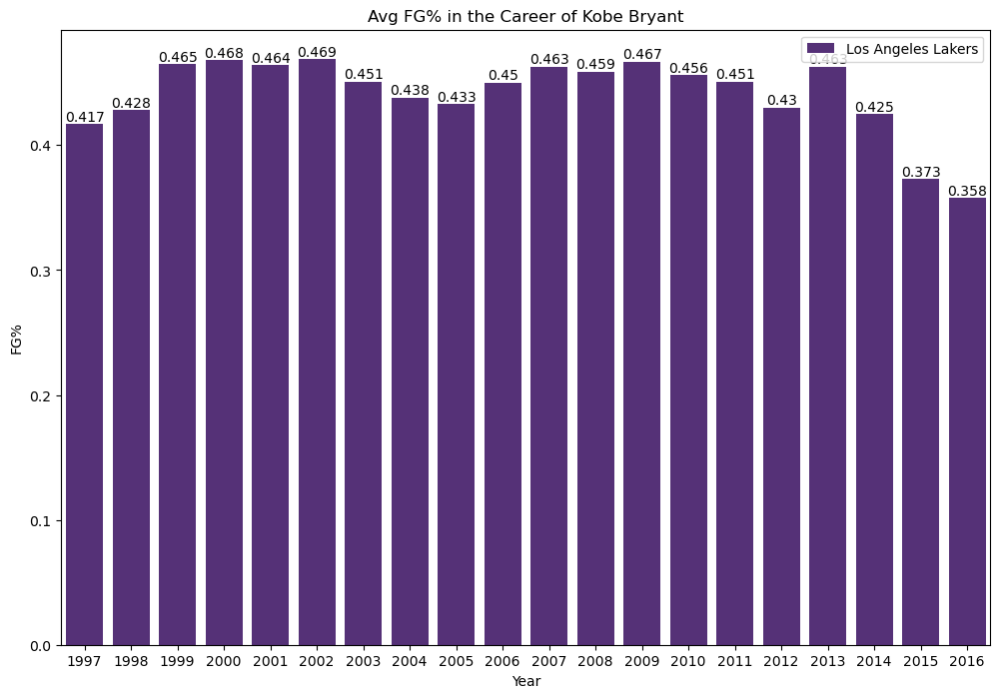

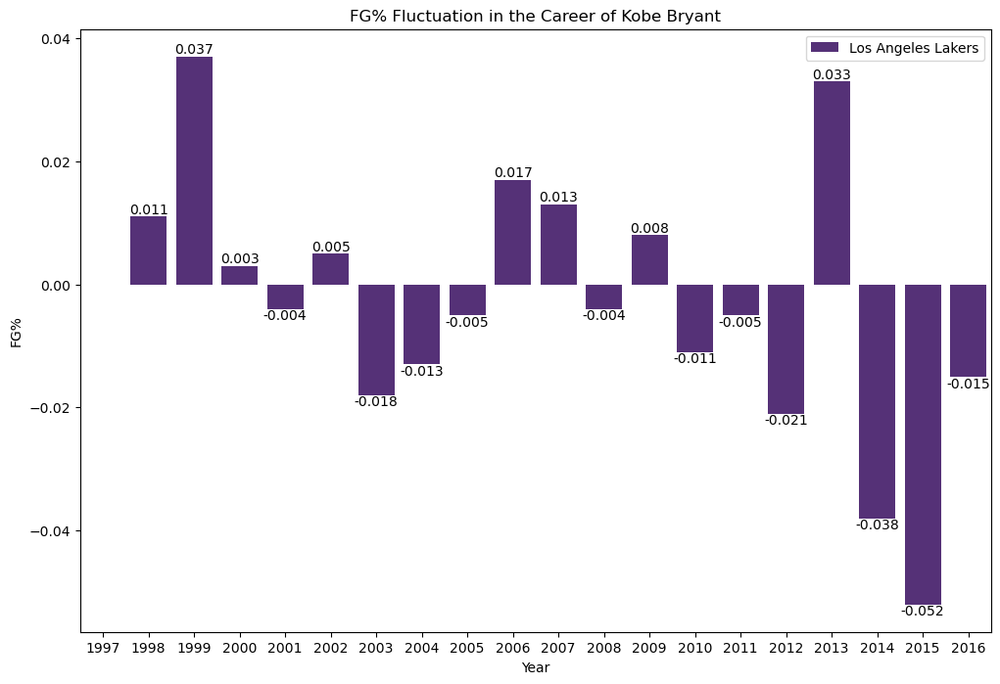

<Figure size 640x480 with 0 Axes>

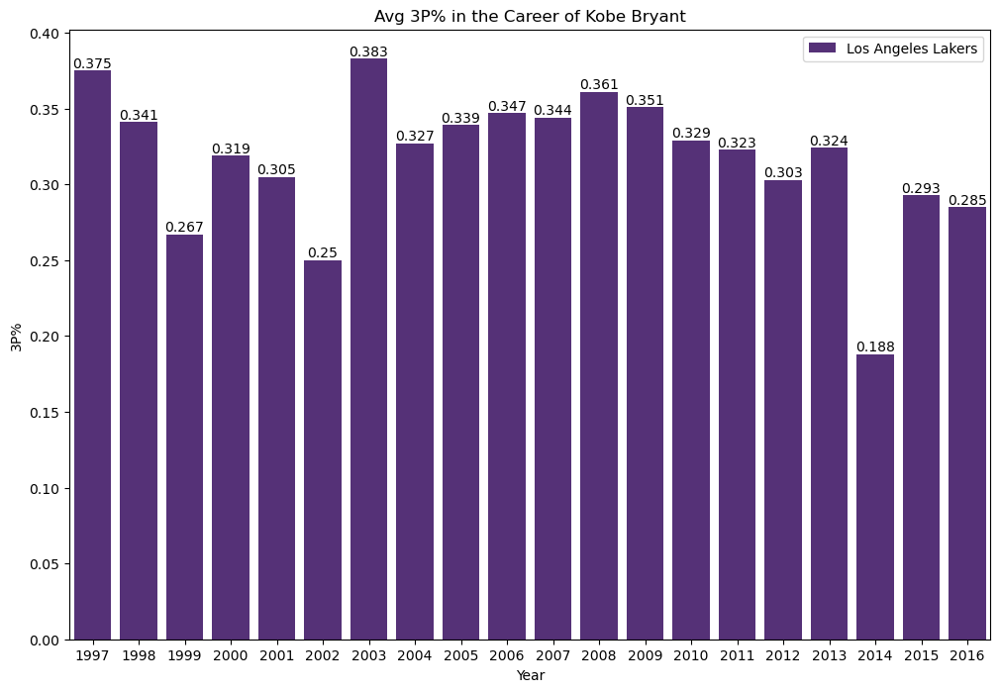

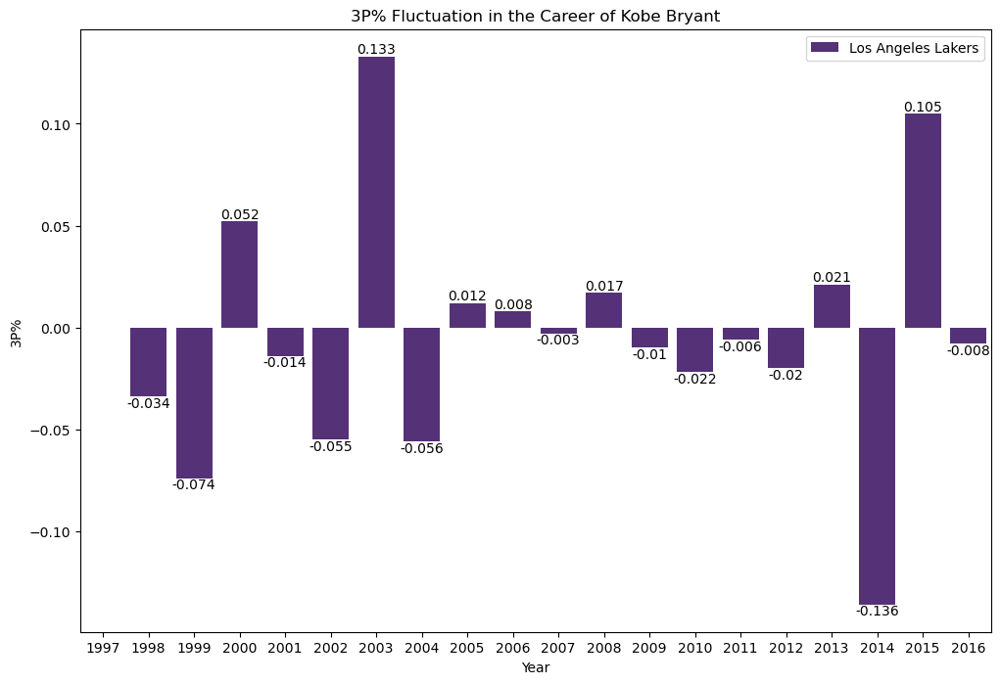

<Figure size 640x480 with 0 Axes>

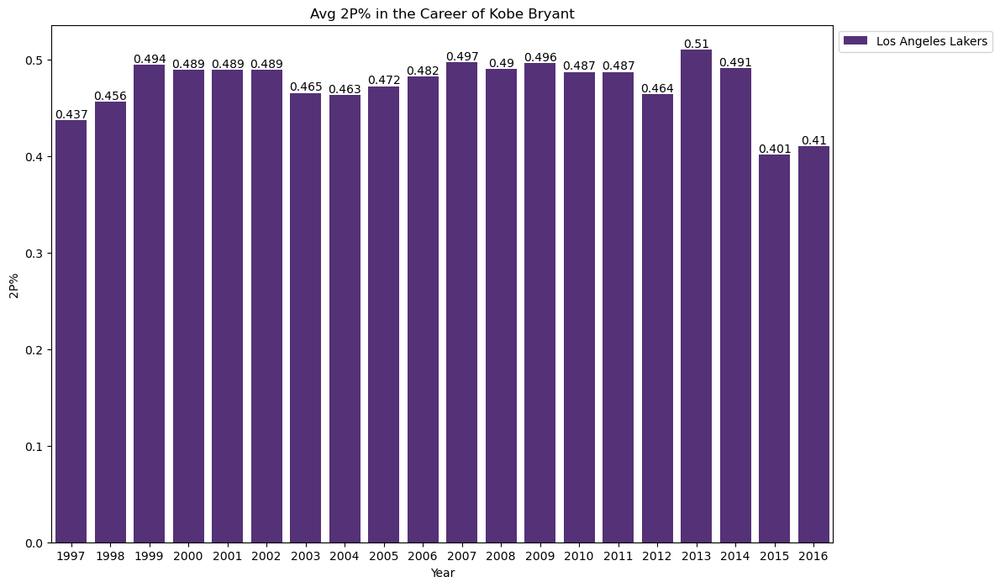

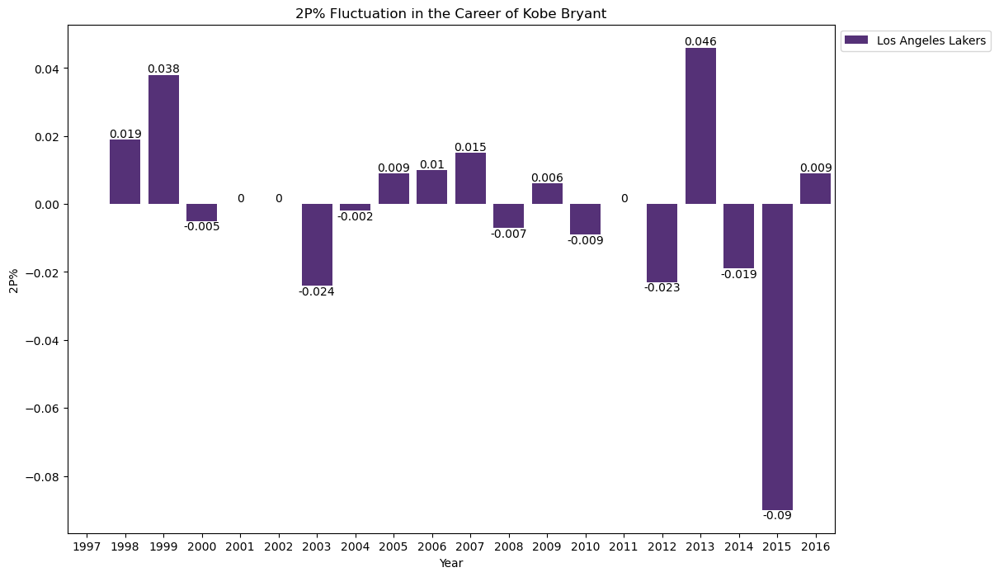

<Figure size 640x480 with 0 Axes>

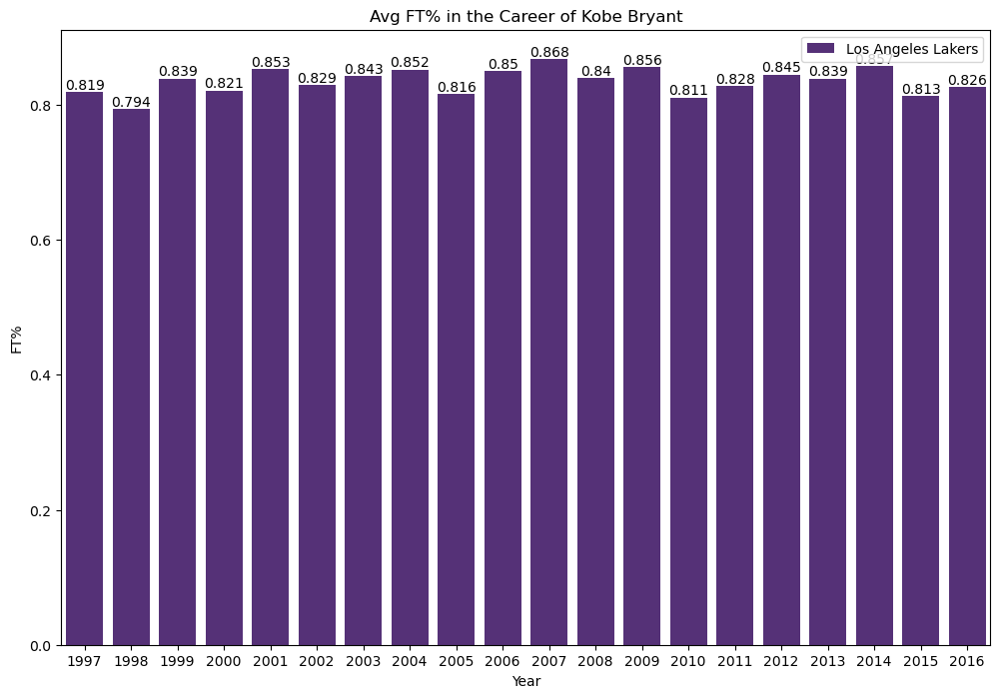

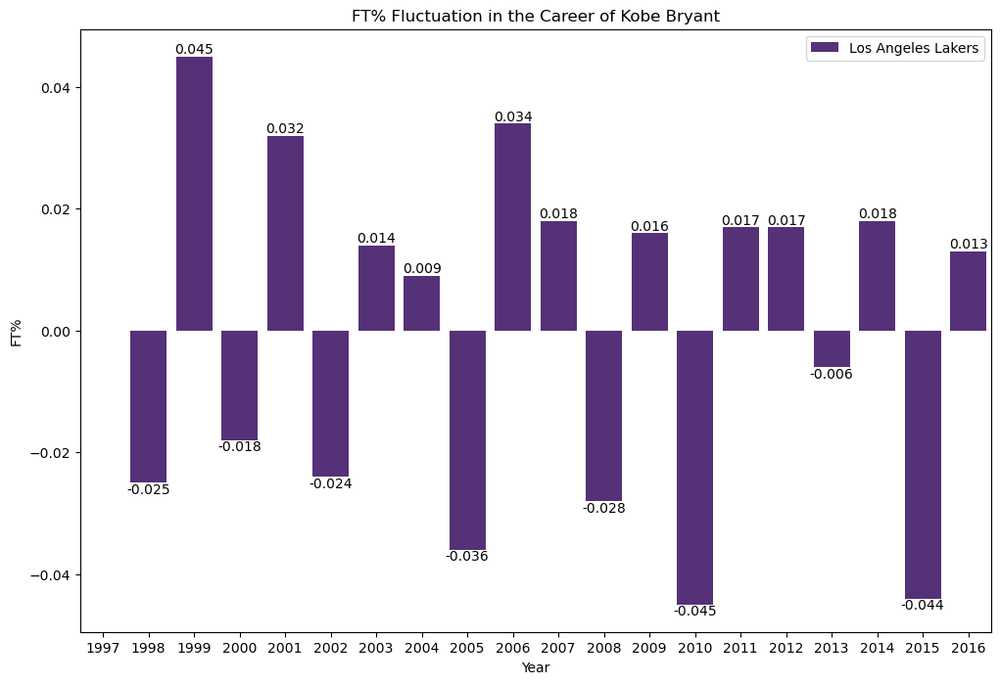

<Figure size 640x480 with 0 Axes>

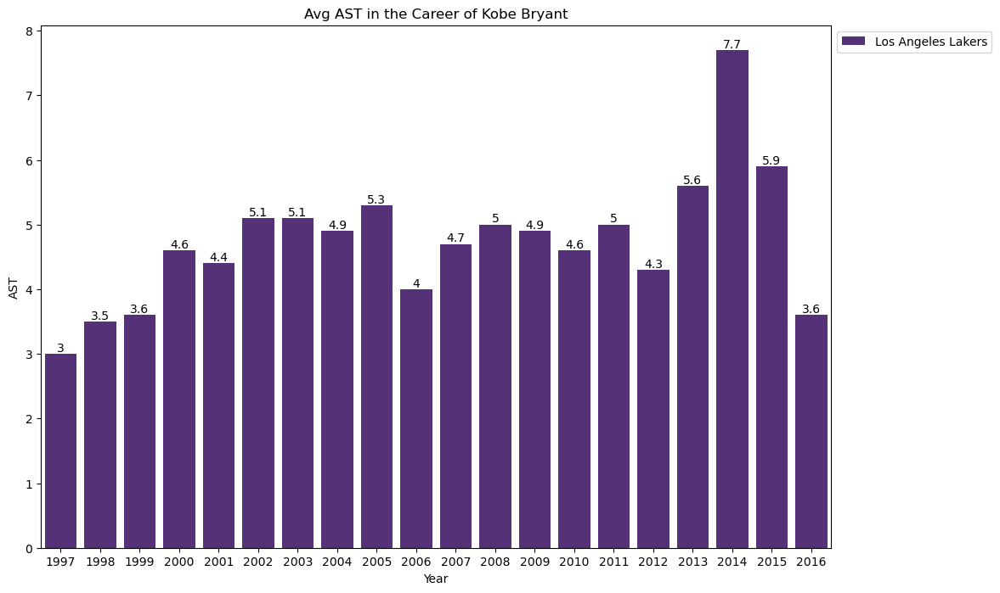

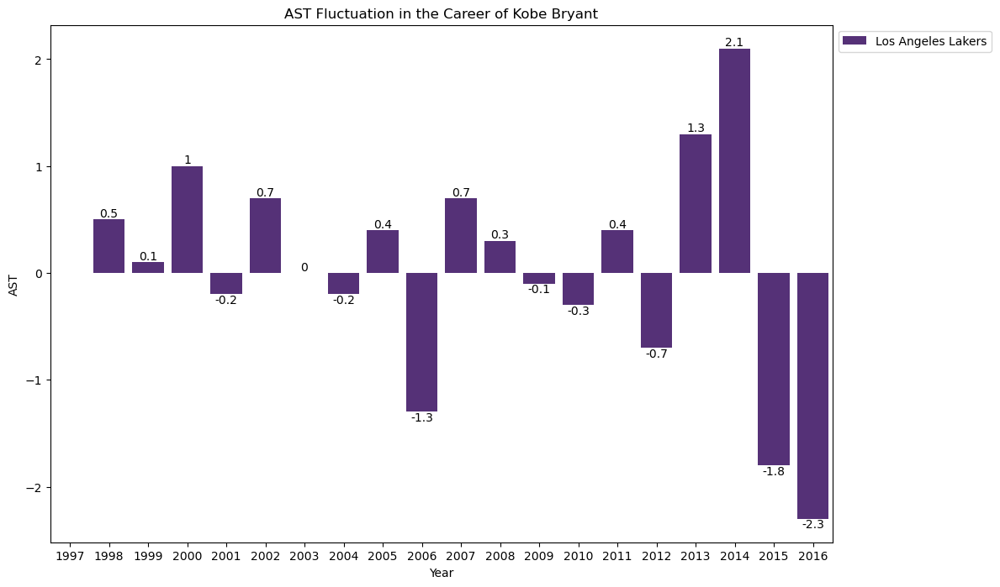

<Figure size 640x480 with 0 Axes>

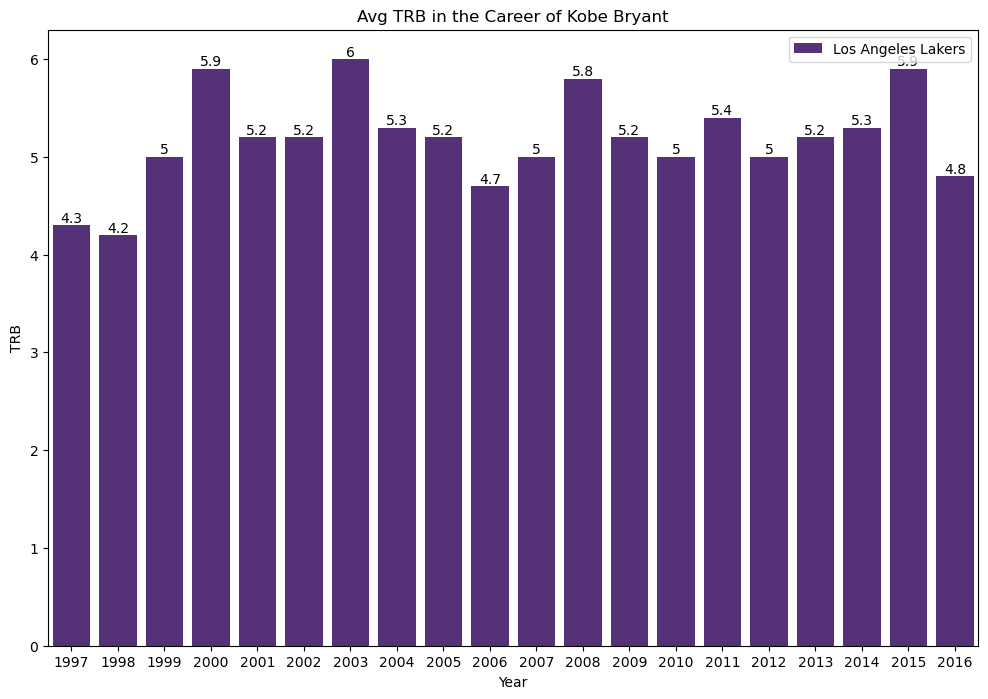

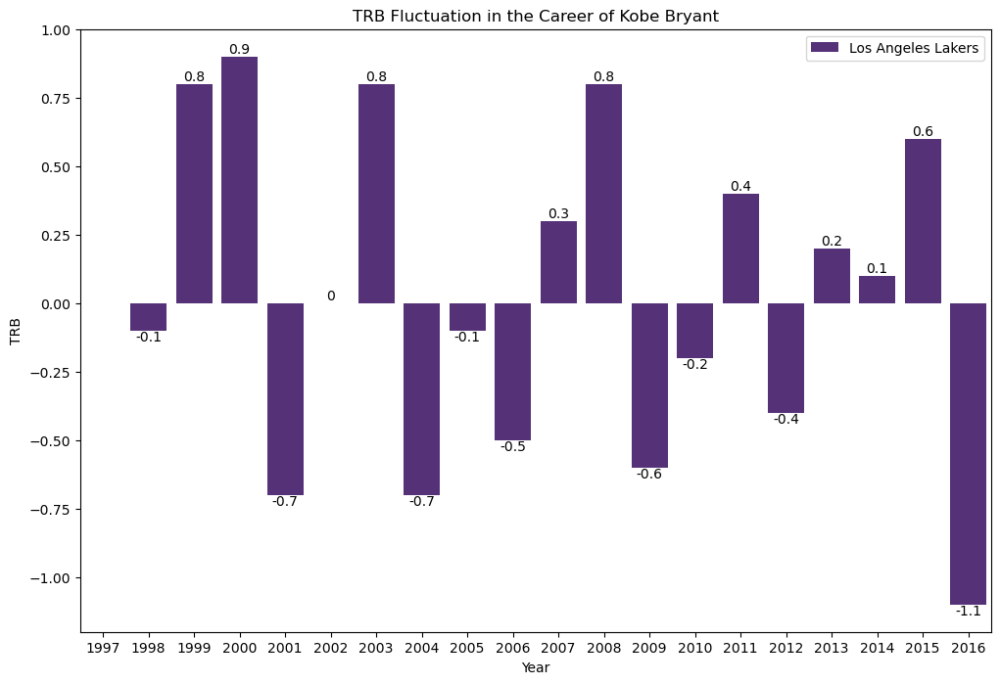

<Figure size 640x480 with 0 Axes>

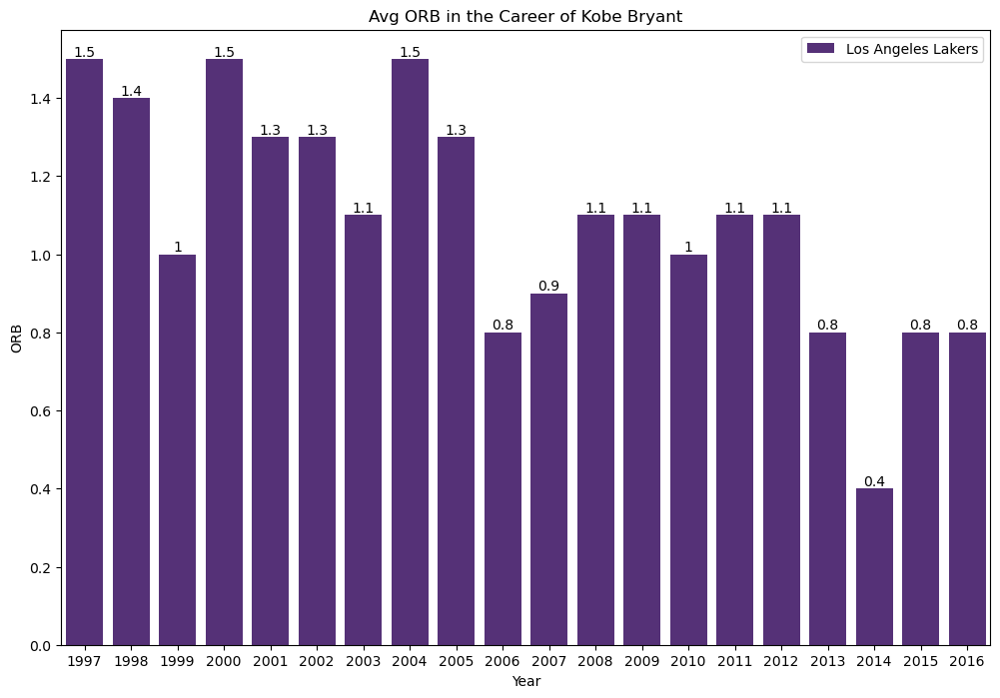

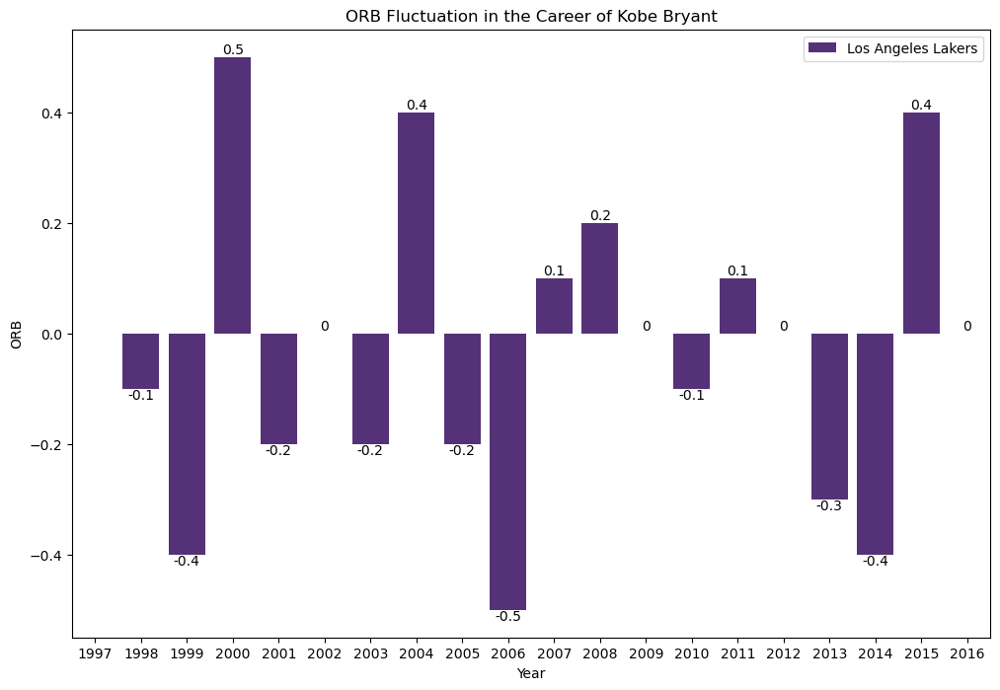

<Figure size 640x480 with 0 Axes>

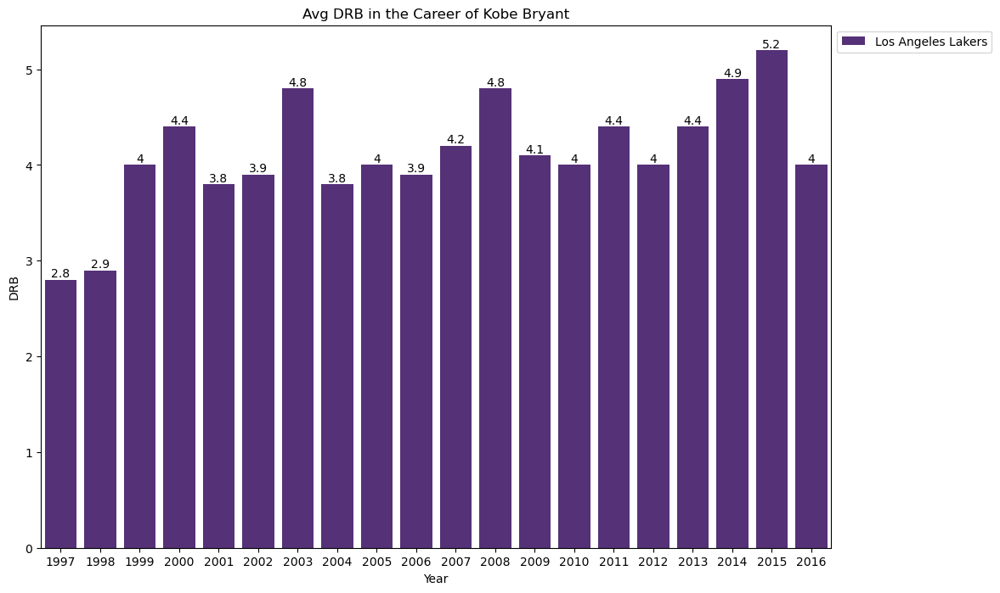

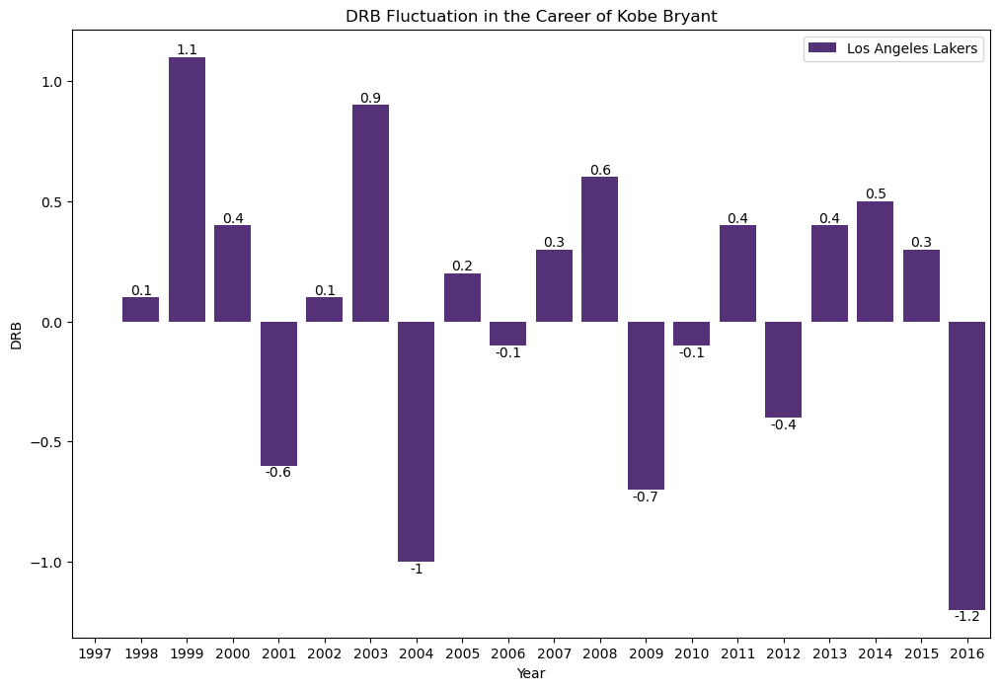

<Figure size 640x480 with 0 Axes>

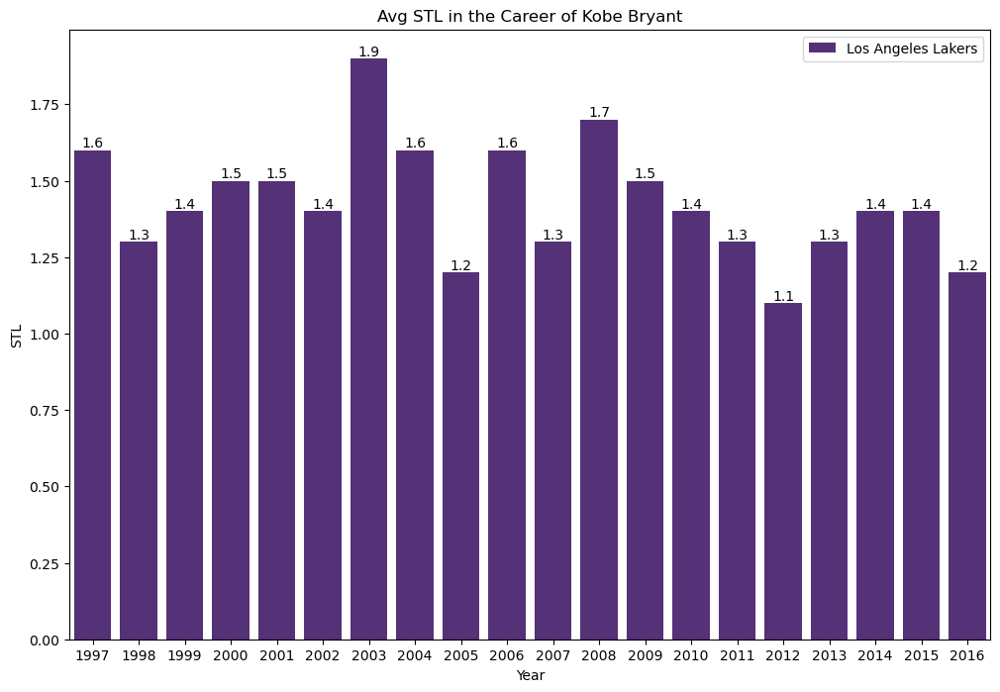

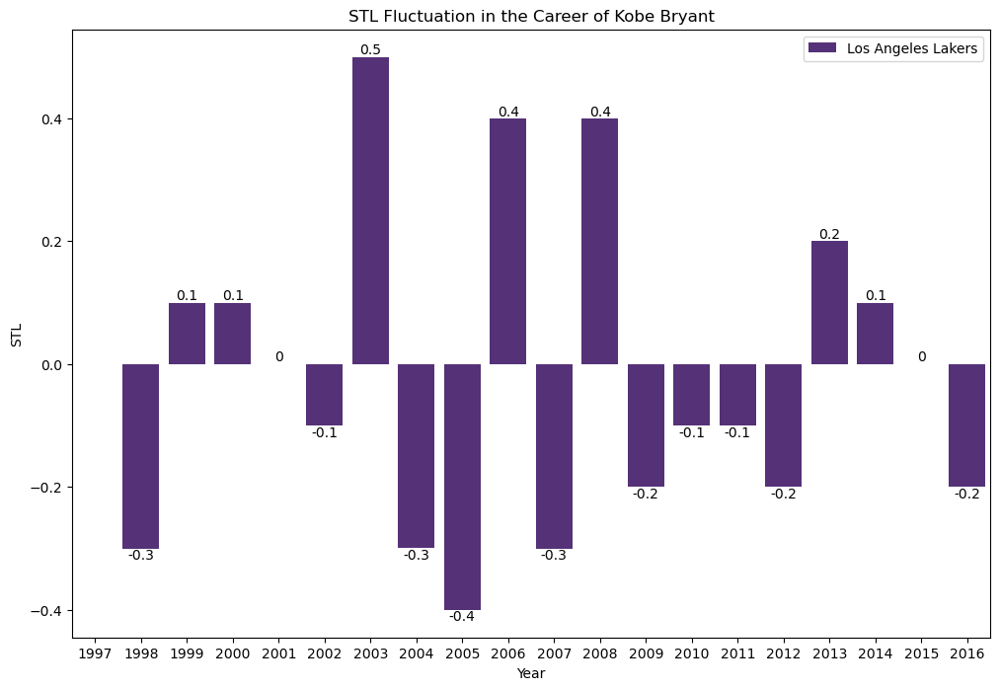

<Figure size 640x480 with 0 Axes>

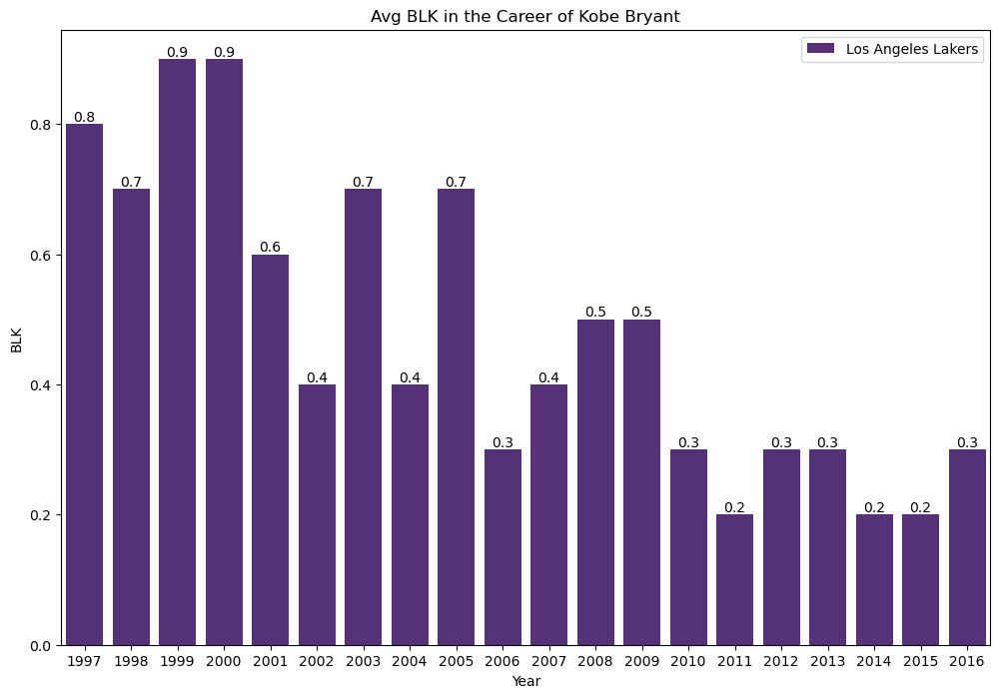

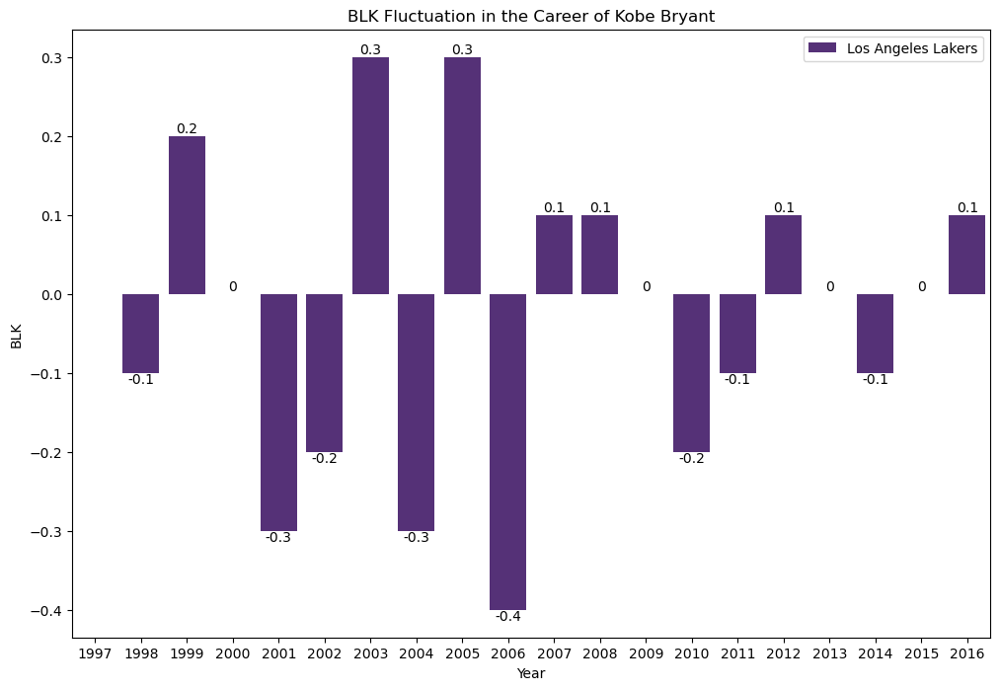

<Figure size 640x480 with 0 Axes>

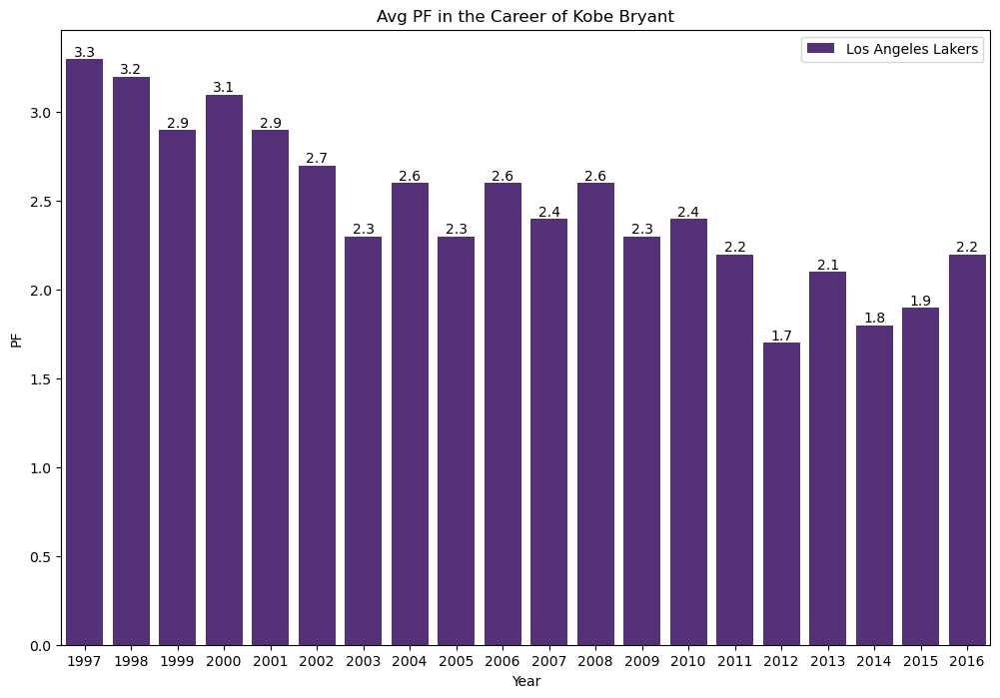

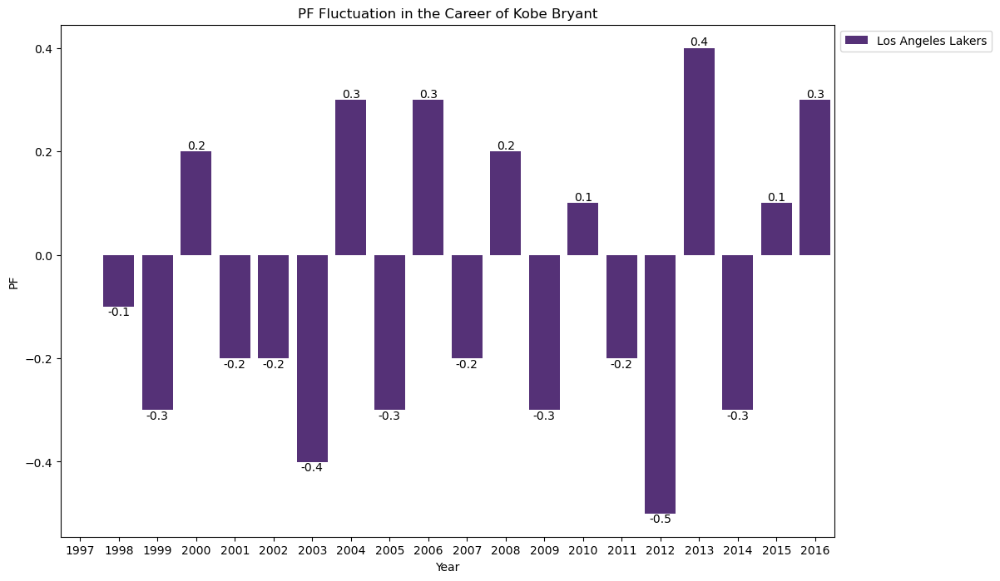

<Figure size 640x480 with 0 Axes>

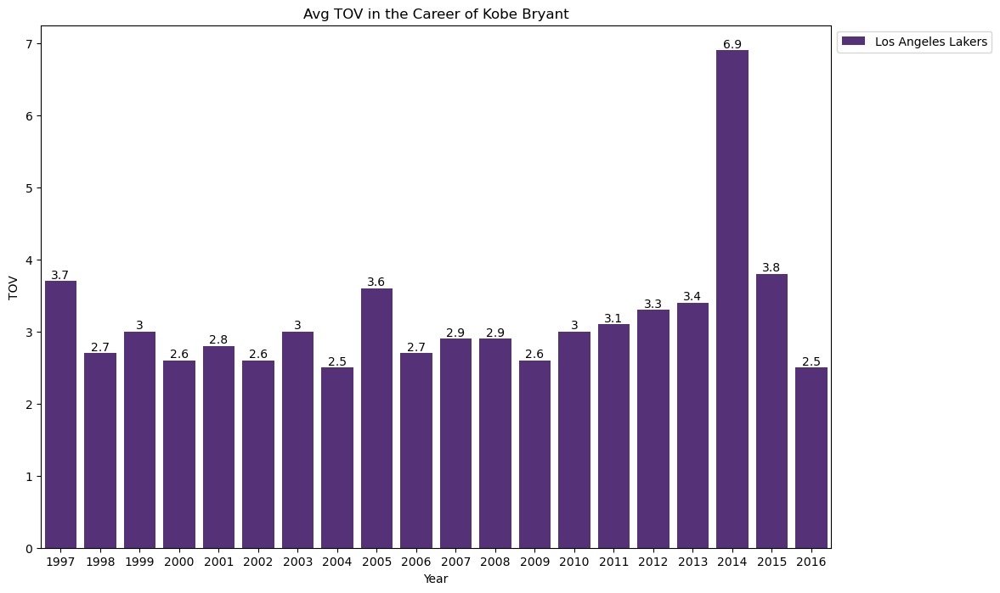

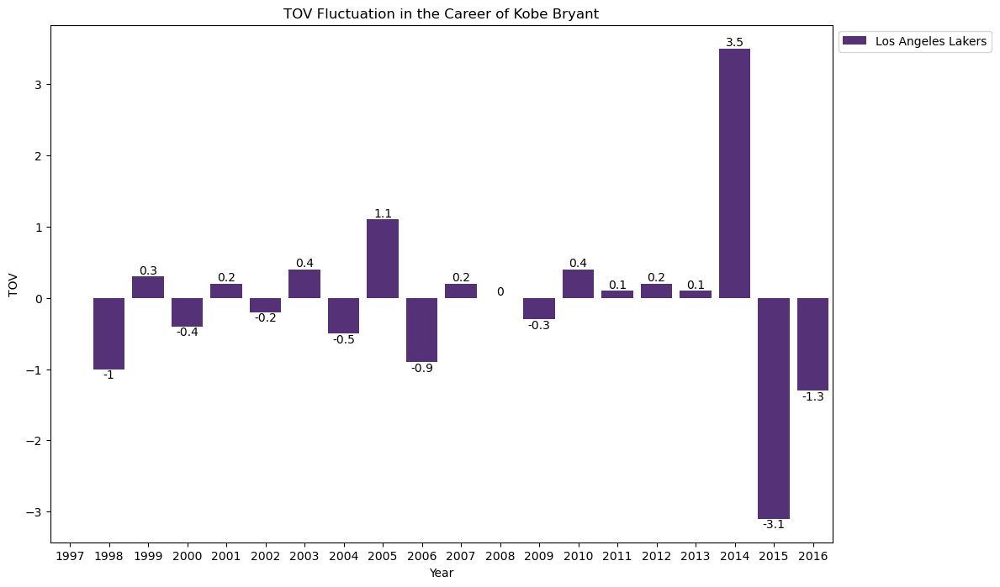

<Figure size 640x480 with 0 Axes>

C:\Users\gandj\anaconda3\Lib\site-packages\plotly\express\_core.py:271: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  trace_data = trace_data.append(trace_data.iloc[0])


In [20]:
nba_player_stats(input("Please enter the player's name: "))

In [21]:
df_avg.to_csv('Avg_Stats_1984_2023.csv')

# Source

Tiodorovic, K. (2020). Efficiency- The Most Important Stat in Basketball. [online] BenchBoss. Available at: https://benchboss.ai/efficiency-the-most-important-stat-in-basketball/

STACK NJ/NY (2021). Redirect Notice. [online] Available at: https://www.google.com/url?q=https://www.stacknj.com/2021/11/07/most-important-statistics-in-winning-basketball-games/&source=gmail&ust=1704586413019000&usg=AOvVaw1JAxWYZBJwFp10YUNnuIDS

basketball stats, (2021). 5 Advanced Basketball Stats Every Team Should Track. [online] Available at: https://www.basketballforcoaches.com/basketball-stats/